# Coca Cola Stock Price

## Objectives


- Enhance Trading Performance with Strategic Close Price Forecasting
- Risk Detection for Low Price: Forecasting and Managing Market Volatility


In [1]:
#pip install pyodbc

# **Connecting to the DataBase**

In [1]:
import pyodbc
import pandas as pd
import matplotlib.pyplot as plt


# Obtenez la liste des pilotes ODBC installés
drivers = [driver for driver in pyodbc.drivers()]

# Affichez la liste des pilotes
for driver in drivers:
    print(driver)

SQL Server
SQL Server Native Client 11.0
Microsoft Access Driver (*.mdb, *.accdb)
Microsoft Excel Driver (*.xls, *.xlsx, *.xlsm, *.xlsb)
Microsoft Access Text Driver (*.txt, *.csv)


In [2]:
import pyodbc
import pandas as pd  # Importez pandas
# Paramètres de connexion
server = 'DESKTOP-ESB8B0G'
database = 'DW_COCACOLA'

# Chaîne de connexion avec authentification Windows
conn_str = (
    f'DRIVER=SQL Server Native Client 11.0;'
    f'SERVER={server};'
    f'DATABASE={database};'
    f'Trusted_Connection=yes;'  # Utilisez l'authentification Windows
)

# Établir la connexion
conn = pyodbc.connect(conn_str)

# **Stock's Performance fact table**

In [3]:

# Exécuter la requête SQL
sql_query = 'SELECT * FROM Fact_Perfomances'
FactPerf = pd.read_sql(sql_query, conn)
FactPerf['Date'] = pd.to_datetime(FactPerf['Date_FK'], format='%Y%m%d', errors='coerce')

FactPerf.set_index('Date',inplace=True)

# Ensure that the index is a datetime type
FactPerf.index = pd.to_datetime(FactPerf.index)
# Afficher les premières lignes du DataFrame
FactPerf


C:\Users\MSI\AppData\Local\Temp\ipykernel_75548\3148141140.py:3: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  FactPerf = pd.read_sql(sql_query, conn)


,Revenue,Profit,High,Low,Open_Price,Close_Price,Adj_Close,Volume,VolumeRate,Date_FK,Company_FK,Location_FK,StockExchange_FK,investor_FK,Change
Date,,,,,,,,,,,,,,,
1997-02-14,46.854,7060.0,30.500000,30.125000,16.043193,30.312500,16.164536,5933000.0,822.447457,19970214,553,119,467153,603.0,0.0
1997-02-18,46.854,7060.0,30.750000,30.250000,30.312500,30.750000,16.397837,0.0,0.000000,19970218,553,119,467153,603.0,0.0
1997-02-19,46.854,7060.0,16.258175,30.625000,30.750000,31.000000,16.531151,5995200.0,830.879448,19970219,553,119,467153,603.0,0.0
1997-02-20,46.854,7060.0,30.937500,16.004907,30.937500,30.625000,16.331175,5168600.0,716.333043,19970220,553,119,467153,603.0,0.0
1997-02-21,46.854,7060.0,31.125000,30.562500,30.625000,31.000000,16.531151,8153200.0,1127.664211,19970221,553,119,467153,603.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1997-02-07,46.854,7060.0,29.187500,28.500000,28.875000,29.125000,15.531282,0.0,0.000000,19970207,553,119,467153,603.0,0.0
1997-02-10,46.854,7060.0,29.812500,29.125000,16.043193,29.125000,15.531282,4787000.0,663.850611,19970210,553,119,467153,603.0,0.0
1997-02-11,46.854,7060.0,29.625000,29.125000,29.125000,16.099507,0.049045,4324600.0,599.736909,19970211,553,119,467153,603.0,0.0


# Data Understanding

In [4]:
print(FactPerf.describe())

         Revenue   Profit          High           Low    Open_Price  \
count  14341.000  14341.0  14341.000000  14341.000000  14341.000000   
mean      46.854   7060.0     16.258175     16.004907     16.043193   
std        0.000      0.0     15.974254     15.721878     15.861115   
min       46.854   7060.0      0.193359      0.182292      0.192708   
25%       46.854   7060.0      0.960938      0.950521      0.937500   
50%       46.854   7060.0     16.258175     16.004907     16.043193   
75%       46.854   7060.0     26.812500     26.209999     26.500000   
max       46.854   7060.0     60.130001     59.619999     59.810001   

        Close_Price     Adj_Close        Volume    VolumeRate       Date_FK  \
count  14341.000000  14341.000000  1.434100e+04  14341.000000  1.434100e+04   
mean      16.099507     10.012126  7.876589e+06   1094.517489  1.990478e+07   
std       15.859949     13.940186  7.972287e+06   1105.887292  1.780315e+05   
min        0.192057      0.037855  0.000000e

In [5]:
print(FactPerf.info())


<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 14341 entries, 1997-02-14 to 1997-02-13
Data columns (total 15 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Revenue           14341 non-null  float64
 1   Profit            14341 non-null  float64
 2   High              14341 non-null  float64
 3   Low               14341 non-null  float64
 4   Open_Price        14341 non-null  float64
 5   Close_Price       14341 non-null  float64
 6   Adj_Close         14341 non-null  float64
 7   Volume            14341 non-null  float64
 8   VolumeRate        14341 non-null  float64
 9   Date_FK           14341 non-null  int64  
 10  Company_FK        14341 non-null  int64  
 11  Location_FK       14341 non-null  int64  
 12  StockExchange_FK  14341 non-null  int64  
 13  investor_FK       13904 non-null  float64
 14  Change            14341 non-null  float64
dtypes: float64(11), int64(4)
memory usage: 1.8 MB
None


In [6]:
print(FactPerf['Close_Price'].nunique())


4932


In [7]:
print(FactPerf['Close_Price'].describe())


count    14341.000000
mean        16.099507
std         15.859949
min          0.192057
25%          0.940104
50%         16.099507
75%         26.620001
max         60.130001
Name: Close_Price, dtype: float64


In [8]:
print("Skewness:", FactPerf['Close_Price'].skew())
print("Kurtosis:", FactPerf['Close_Price'].kurt())


Skewness: 0.7201770327226263
Kurtosis: -0.6023092381041386


# Data Preparation

### **Treating null and duplicate values**

In [9]:
FactPerf.isnull().sum()

Revenue               0
Profit                0
High                  0
Low                   0
Open_Price            0
Close_Price           0
Adj_Close             0
Volume                0
VolumeRate            0
Date_FK               0
Company_FK            0
Location_FK           0
StockExchange_FK      0
investor_FK         437
Change                0
dtype: int64

In [10]:
FactPerf.dropna(inplace=True)
FactPerf.isnull().sum()

Revenue             0
Profit              0
High                0
Low                 0
Open_Price          0
Close_Price         0
Adj_Close           0
Volume              0
VolumeRate          0
Date_FK             0
Company_FK          0
Location_FK         0
StockExchange_FK    0
investor_FK         0
Change              0
dtype: int64

In [11]:
FactPerf.duplicated().sum()

126

In [12]:
FactPerf.drop_duplicates(inplace=True)


In [13]:
FactPerf.duplicated().sum()

0

In [14]:
# Triez votre DataFrame par la colonne Date_FK
FactPerf = FactPerf.sort_values(by=['Date_FK'])

# Calculez la colonne "Change" en pourcentage
FactPerf['Change'] = ((FactPerf['Close_Price'] - FactPerf['Close_Price'].shift(1)) / FactPerf['Close_Price'].shift(1)) * 100
# Remplacez les valeurs NaN dans la première ligne par 0, car il n'y a pas de valeur précédente
FactPerf['Change'].dropna

# Affichez les premières lignes du DataFrame avec la colonne "Change" calculée
FactPerf

,Revenue,Profit,High,Low,Open_Price,Close_Price,Adj_Close,Volume,VolumeRate,Date_FK,Company_FK,Location_FK,StockExchange_FK,investor_FK,Change
Date,,,,,,,,,,,,,,,
1962-01-03,46.854,7060.0,0.259115,0.253255,0.259115,0.257161,0.049994,1574400.0,221.500562,19620103,553,119,467153,603.0,NaN
1962-01-04,46.854,7060.0,16.258175,0.257813,0.257813,0.259115,0.050374,844800.0,118.586947,19620104,553,119,467153,603.0,0.759843
1962-01-05,46.854,7060.0,0.262370,0.252604,0.259115,0.253255,0.049234,0.0,0.000000,19620105,553,119,467153,603.0,-2.261544
1962-01-08,46.854,7060.0,16.258175,0.245768,0.251302,16.099507,0.048728,2035200.0,285.053644,19620108,553,119,467153,603.0,6257.033887
1962-01-09,46.854,7060.0,0.256510,0.248698,0.250651,0.255208,0.049614,960000.0,135.061652,19620109,553,119,467153,603.0,-98.414809
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-12-09,46.854,7060.0,55.130001,54.590000,54.750000,54.860001,54.860001,13846400.0,1889.988021,20211209,553,119,467153,603.0,-0.254544
2021-12-13,46.854,7060.0,57.930000,56.959999,16.043193,57.759998,57.759998,31362800.0,4298.896187,20211213,553,119,467153,603.0,5.286179
2021-12-14,46.854,7060.0,58.169998,57.400002,57.400002,57.799999,57.799999,0.0,0.000000,20211214,553,119,467153,603.0,0.069254


# *Feature engineering*

In [15]:
FactPerf['Range'] = (FactPerf['High'] - FactPerf['Low'])
FactPerf['Revenue'] =FactPerf['Revenue']*1000
FactPerf['Profit_Margin'] =(FactPerf['Profit'] -FactPerf['Revenue'])*100
FactPerf['Return']=100*(FactPerf['Close_Price']-FactPerf['Open_Price'])/FactPerf['Open_Price']
FactPerf['Price_Difference'] = FactPerf['Close_Price'] - FactPerf['Open_Price']
# Calculate daily gains and losses
FactPerf['Gain'] = FactPerf['Close_Price'].diff()
FactPerf['Loss'] = -FactPerf['Gain'].apply(lambda x: min(0, x))
FactPerf=FactPerf.drop('Date_FK',axis=1)
# Calculate average gains and losses over the specified period
n=7
FactPerf['Avg Gain'] = FactPerf['Gain'].rolling(window=n).mean()
FactPerf['Avg Loss'] = FactPerf['Loss'].rolling(window=n).mean()
# Calculate RS and RSIF
FactPerf['RS'] = FactPerf['Avg Gain'] / FactPerf['Avg Loss']
FactPerf['RSI'] = 100 - (100 / (1 + FactPerf['RS']))
columns_to_delete = ["Company_FK", "Location_FK", "StockExchange_FK", "investor_FK"]
FactPerf = FactPerf.drop(columns=columns_to_delete)
FactPerf

,Revenue,Profit,High,Low,Open_Price,Close_Price,Adj_Close,Volume,VolumeRate,Change,Range,Profit_Margin,Return,Price_Difference,Gain,Loss,Avg Gain,Avg Loss,RS,RSI
Date,,,,,,,,,,,,,,,,,,,,
1962-01-03,46854.000092,7060.0,0.259115,0.253255,0.259115,0.257161,0.049994,1574400.0,221.500562,NaN,0.005860,-3.979400e+06,-0.754113,-0.001954,NaN,-0.000000,NaN,NaN,NaN,NaN
1962-01-04,46854.000092,7060.0,16.258175,0.257813,0.257813,0.259115,0.050374,844800.0,118.586947,0.759843,16.000362,-3.979400e+06,0.505019,0.001302,0.001954,-0.000000,NaN,NaN,NaN,NaN
1962-01-05,46854.000092,7060.0,0.262370,0.252604,0.259115,0.253255,0.049234,0.0,0.000000,-2.261544,0.009766,-3.979400e+06,-2.261544,-0.005860,-0.005860,0.005860,NaN,NaN,NaN,NaN
1962-01-08,46854.000092,7060.0,16.258175,0.245768,0.251302,16.099507,0.048728,2035200.0,285.053644,6257.033887,16.012407,-3.979400e+06,6306.437886,15.848205,15.846252,-0.000000,NaN,NaN,NaN,NaN
1962-01-09,46854.000092,7060.0,0.256510,0.248698,0.250651,0.255208,0.049614,960000.0,135.061652,-98.414809,0.007812,-3.979400e+06,1.818059,0.004557,-15.844299,15.844299,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-12-09,46854.000092,7060.0,55.130001,54.590000,54.750000,54.860001,54.860001,13846400.0,1889.988021,-0.254544,0.540001,-3.979400e+06,0.200914,0.110001,-0.139999,0.139999,0.344286,5.585785,0.061636,5.805760
2021-12-13,46854.000092,7060.0,57.930000,56.959999,16.043193,57.759998,57.759998,31362800.0,4298.896187,5.286179,0.970001,-3.979400e+06,260.028081,41.716806,2.899998,-0.000000,0.780000,5.564356,0.140178,12.294390
2021-12-14,46854.000092,7060.0,58.169998,57.400002,57.400002,57.799999,57.799999,0.0,0.000000,0.069254,0.769997,-3.979400e+06,0.696860,0.399998,0.040001,-0.000000,0.675714,5.564356,0.121436,10.828632


In [16]:
FactPerf.dropna(inplace=True)


## Treating Outliers

In [17]:
# Liste des colonnes numériques que vous souhaitez vérifier
colonnes_numeriques =['Open_Price', 'High', 'Low', 'Close_Price', 'Adj_Close', 'Volume', 'VolumeRate','Change','Revenue','Profit','Avg Gain','Avg Loss','RS','RSI']

# Parcourir chaque colonne
for colonne in colonnes_numeriques:
    # Calculez les quartiles Q1 (25e percentile) et Q3 (75e percentile)
    Q1 = FactPerf[colonne].quantile(0.25)
    Q3 = FactPerf[colonne].quantile(0.75)

    # Calculez l'IQR (Interquartile Range)
    IQR = Q3 - Q1

    # Calculez les limites pour les valeurs aberrantes
    borne_inferieure = Q1 - 1.5 * IQR
    borne_superieure = Q3 + 1.5 * IQR

    # Vérifiez quelles lignes contiennent des valeurs aberrantes dans la colonne sélectionnée
    valeurs_aberrantes = FactPerf[(FactPerf[colonne] < borne_inferieure) | (FactPerf[colonne] > borne_superieure)]

    # Affichez les lignes contenant des valeurs aberrantes pour cette colonne, si elles existent
    if not valeurs_aberrantes.empty:
        print(f"\nLignes avec des valeurs aberrantes dans la colonne '{colonne}':")
        print(valeurs_aberrantes)
    else :
         print(f"\nPas des valeurs aberrantes pour: '{colonne}':")


Pas des valeurs aberrantes pour: 'Open_Price':

Pas des valeurs aberrantes pour: 'High':

Pas des valeurs aberrantes pour: 'Low':

Pas des valeurs aberrantes pour: 'Close_Price':

Lignes avec des valeurs aberrantes dans la colonne 'Adj_Close':
                 Revenue  Profit       High        Low  Open_Price  \
Date                                                                 
2017-11-14  46854.000092  7060.0  47.480000  46.619999   16.043193   
2018-01-17  46854.000092  7060.0  47.000000  46.549999   46.580002   
2018-01-18  46854.000092  7060.0  47.070000  46.610001   46.750000   
2018-01-19  46854.000092  7060.0  16.258175  46.869999   46.990002   
2018-01-22  46854.000092  7060.0  47.500000  47.090000   47.139999   
...                  ...     ...        ...        ...         ...   
2021-12-09  46854.000092  7060.0  55.130001  54.590000   54.750000   
2021-12-13  46854.000092  7060.0  57.930000  56.959999   16.043193   
2021-12-14  46854.000092  7060.0  58.169998  57.400002 

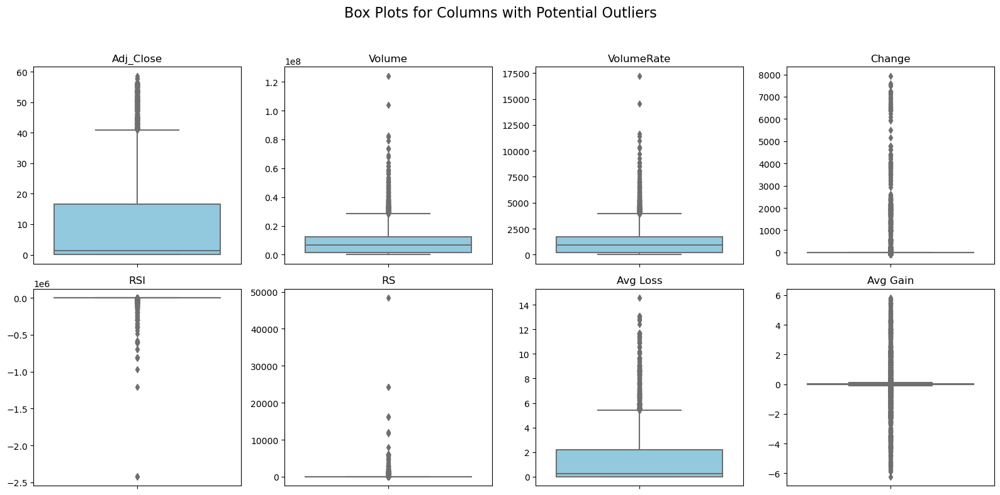

In [18]:
import matplotlib.pyplot as plt
import seaborn as sns

# Define the columns with potential outliers
columns_with_outliers = ['Adj_Close', 'Volume', 'VolumeRate', 'Change', 'RSI', 'RS', 'Avg Loss', 'Avg Gain']

# Create subplots for each column in a 2x4 grid
fig, axes = plt.subplots(2, 4, figsize=(16, 8))
fig.suptitle('Box Plots for Columns with Potential Outliers', fontsize=16)

# Create box plots for each column
for i, column in enumerate(columns_with_outliers):
    sns.boxplot(data=FactPerf, y=column, ax=axes[i // 4, i % 4], color='skyblue')
    axes[i // 4, i % 4].set_title(column)
    axes[i // 4, i % 4].set_ylabel('')
    axes[i // 4, i % 4].set_xlabel('')

# Adjust layout
plt.tight_layout(rect=[0, 0, 1, 0.95])

# Show the plots
plt.show()


**Handling Outliers in Specific Columns and Replacing with Max and Min Non-Outlier Values**

In [19]:
import pandas as pd


# Define the columns with outliers
columns_with_outliers = ['Adj_Close', 'Volume', 'VolumeRate', 'Change', 'RSI', 'RS', 'Avg Loss', 'Avg Gain']

# Loop through each column with outliers
for column in columns_with_outliers:
    # Calculate the IQR (Interquartile Range)
    Q1 = FactPerf[column].quantile(0.25)
    Q3 = FactPerf[column].quantile(0.75)
    IQR = Q3 - Q1

    # Define the lower and upper bounds for identifying outliers
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR

    # Identify high and low outliers
    high_outliers = FactPerf[FactPerf[column] > upper_bound]
    low_outliers = FactPerf[FactPerf[column] < lower_bound]

    # Replace high outliers with the maximum non-outlier value in the column
    max_non_outlier = FactPerf[(FactPerf[column] >= lower_bound) & (FactPerf[column] <= upper_bound)][column].max()
    FactPerf.loc[high_outliers.index, column] = max_non_outlier

    # Replace low outliers with the minimum non-outlier value in the column
    min_non_outlier = FactPerf[(FactPerf[column] >= lower_bound) & (FactPerf[column] <= upper_bound)][column].min()
    FactPerf.loc[low_outliers.index, column] = min_non_outlier

# Now, df contains the outliers in the specified columns replaced with max and min non-outlier values


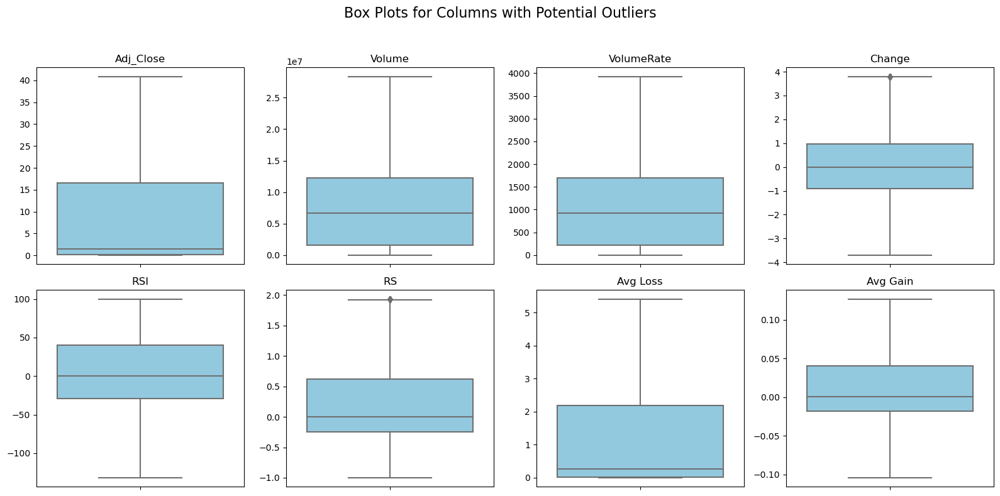

In [20]:
import matplotlib.pyplot as plt
import seaborn as sns

# Define the columns with potential outliers
columns_with_outliers = ['Adj_Close', 'Volume', 'VolumeRate', 'Change', 'RSI', 'RS', 'Avg Loss', 'Avg Gain']

# Create subplots for each column in a 2x4 grid
fig, axes = plt.subplots(2, 4, figsize=(16, 8))
fig.suptitle('Box Plots for Columns with Potential Outliers', fontsize=16)

# Create box plots for each column
for i, column in enumerate(columns_with_outliers):
    sns.boxplot(data=FactPerf, y=column, ax=axes[i // 4, i % 4], color='skyblue')
    axes[i // 4, i % 4].set_title(column)
    axes[i // 4, i % 4].set_ylabel('')
    axes[i // 4, i % 4].set_xlabel('')

# Adjust layout
plt.tight_layout(rect=[0, 0, 1, 0.95])

# Show the plots
plt.show()


# *Feature scaling*

In [21]:
FactPerf

,Revenue,Profit,High,Low,Open_Price,Close_Price,Adj_Close,Volume,VolumeRate,Change,Range,Profit_Margin,Return,Price_Difference,Gain,Loss,Avg Gain,Avg Loss,RS,RSI
Date,,,,,,,,,,,,,,,,,,,,
1962-01-12,46854.000092,7060.0,0.259115,0.254557,0.259115,0.257161,0.049994,883200.0,124.256390,-3.699926,0.004558,-3.979400e+06,-0.754113,-0.001954,-15.842346,15.842346,0.000000,4.527501,0.000000,0.000000
1962-01-15,46854.000092,7060.0,0.256510,0.253906,0.256510,0.254557,0.049488,614400.0,86.439331,-1.012587,0.002604,-3.979400e+06,-0.761364,-0.001953,-0.002604,0.002604,-0.000651,4.527873,-0.000144,-0.014383
1962-01-16,46854.000092,7060.0,0.253906,16.004907,0.253906,16.099507,0.048602,1113600.0,155.978047,3.801665,-15.751001,-3.979400e+06,6240.734779,15.845601,15.844950,-0.000000,0.127143,4.527036,0.500051,33.335616
1962-01-17,46854.000092,7060.0,0.250000,0.242188,0.250000,0.242188,0.047083,1574400.0,221.501941,-3.699926,0.007812,-3.979400e+06,-3.124797,-0.007812,-15.857319,15.857319,-0.104286,5.415785,-0.333511,-50.040059
1962-01-18,46854.000092,7060.0,0.243490,0.236328,0.242188,16.099507,0.046134,2649600.0,371.942826,3.801665,0.007162,-3.979400e+06,6547.524379,15.857319,15.857319,-0.000000,0.127143,4.528896,0.499784,33.323749
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-12-09,46854.000092,7060.0,55.130001,54.590000,54.750000,54.860001,40.911053,13846400.0,1889.988021,-0.254544,0.540001,-3.979400e+06,0.200914,0.110001,-0.139999,0.139999,0.127143,5.415785,0.061636,5.805760
2021-12-13,46854.000092,7060.0,57.930000,56.959999,16.043193,57.759998,40.911053,28368000.0,3928.395445,3.801665,0.970001,-3.979400e+06,260.028081,41.716806,2.899998,-0.000000,0.127143,5.415785,0.140178,12.294390
2021-12-14,46854.000092,7060.0,58.169998,57.400002,57.400002,57.799999,40.911053,0.0,0.000000,0.069254,0.769997,-3.979400e+06,0.696860,0.399998,0.040001,-0.000000,0.127143,5.415785,0.121436,10.828632


In [22]:
import matplotlib.pyplot as plt
import seaborn as sns

def plotDistribution(FactPerf, nRows, nGraphPerRow):
    columnNames = FactPerf.columns
    totalColumns = len(columnNames)
    totalPlots = nRows * nGraphPerRow

    fig, ax = plt.subplots(nrows=nRows, ncols=nGraphPerRow, figsize=(20, 10))

    for i in range(totalPlots):
        if i < totalColumns:
            row = i // nGraphPerRow
            col = i % nGraphPerRow
            sns.histplot(FactPerf[columnNames[i]], ax=ax[row, col], kde=True)
        else:
            # Remove any extra empty subplots
            ax.flat[i].set_visible(False)

    plt.tight_layout(pad=1.0, w_pad=1.0, h_pad=1.0)
    plt.show()

# Usage example:
# Replace 'your_df' with your DataFrame and specify the number of rows and graphs per row.
# plotDistribution(your_df, nRows, nGraphPerRow)


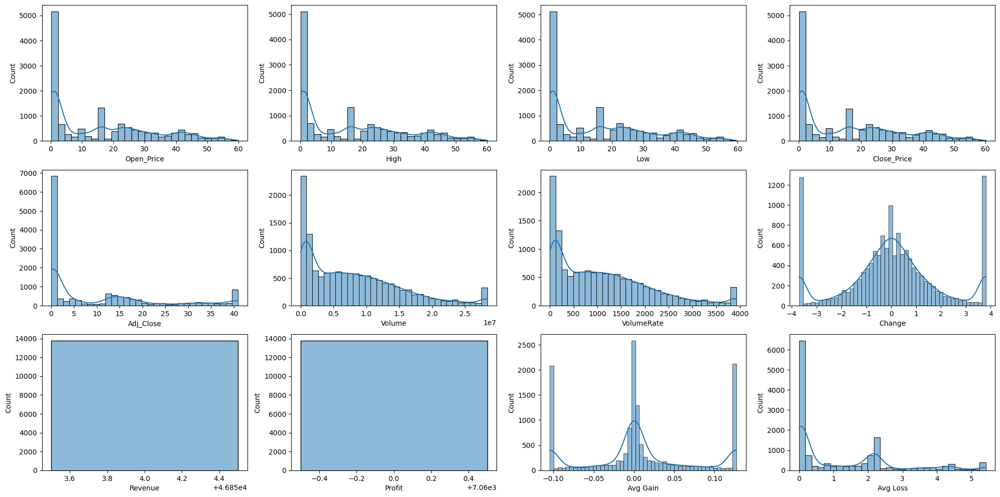

In [23]:
#df1 = FactPerf[['Open_Price', 'High', 'Low', 'Close_Price', 'Adj_Close', 'Volume', 'VolumeRate','Change','Revenue','Profit']]
df1 = FactPerf[['Open_Price', 'High', 'Low', 'Close_Price', 'Adj_Close', 'Volume', 'VolumeRate','Change','Revenue','Profit','Avg Gain','Avg Loss','RS','RSI']]
plotDistribution(df1, 3, 4)  # You may want to adjust the layout as needed


**Feature Scaling: Standardization (Z-score Scaling) for the Adj Close column to the Range [-1, 1]**

In [24]:

# Define the custom range
custom_range_min = -1
custom_range_max = 1

# Select the columns to be scaled
columns_to_scale = ['Change','Avg Gain']

for column_to_scale in columns_to_scale:
    # Calculate the minimum and maximum values in the column
    min_value = FactPerf[column_to_scale].min()
    max_value = FactPerf[column_to_scale].max()

    # Manually scale the data to the custom range
    FactPerf[column_to_scale] = custom_range_min + (FactPerf[column_to_scale] - min_value) * (custom_range_max - custom_range_min) / (max_value - min_value)


**Feature Scaling: Min-Max Scaling (Normalization) for the Close , Open ,High ,Low etc...columns**

In [25]:
from sklearn.preprocessing import MinMaxScaler

# Columns to be scaled with Min-Max scaling
columns_to_normalize =['Open_Price', 'High', 'Low', 'Close_Price', 'Volume', 'VolumeRate','Change','Revenue','Profit','Avg Loss','RS','RSI']


# Create a MinMaxScaler instance
scaler = MinMaxScaler()

# Fit and transform the scaler on the selected columns
FactPerf[columns_to_normalize] = scaler.fit_transform(FactPerf[columns_to_normalize])


In [26]:

FactPerf

,Revenue,Profit,High,Low,Open_Price,Close_Price,Adj_Close,Volume,VolumeRate,Change,Range,Profit_Margin,Return,Price_Difference,Gain,Loss,Avg Gain,Avg Loss,RS,RSI
Date,,,,,,,,,,,,,,,,,,,,
1962-01-12,0.0,0.0,0.001097,0.001216,0.001114,0.001086,0.049994,0.031134,0.031630,0.000000,0.004558,-3.979400e+06,-0.754113,-0.001954,-15.842346,15.842346,-0.098765,0.835982,0.340580,0.568721
1962-01-15,0.0,0.0,0.001054,0.001205,0.001070,0.001043,0.049488,0.021658,0.022004,0.358236,0.002604,-3.979400e+06,-0.761364,-0.001953,-0.002604,0.002604,-0.104392,0.836051,0.340531,0.568659
1962-01-16,0.0,0.0,0.001010,0.266205,0.001027,0.265399,0.048602,0.039255,0.039705,1.000000,-15.751001,-3.979400e+06,6240.734779,15.845601,15.844950,-0.000000,1.000000,0.835896,0.510888,0.712490
1962-01-17,0.0,0.0,0.000945,0.001008,0.000961,0.000836,0.047083,0.055499,0.056385,0.000000,0.007812,-3.979400e+06,-3.124797,-0.007812,-15.857319,15.857319,-1.000000,1.000000,0.226993,0.352908
1962-01-18,0.0,0.0,0.000836,0.000909,0.000830,0.265399,0.046134,0.093401,0.094681,1.000000,0.007162,-3.979400e+06,6547.524379,15.857319,15.857319,-0.000000,1.000000,0.836240,0.510797,0.712439
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-12-09,0.0,0.0,0.916579,0.915374,0.915125,0.912076,40.911053,0.488099,0.481109,0.459287,0.540001,-3.979400e+06,0.200914,0.110001,-0.139999,0.139999,1.000000,1.000000,0.361572,0.593760
2021-12-13,0.0,0.0,0.963295,0.955247,0.265871,0.960459,40.911053,1.000000,1.000000,1.000000,0.970001,-3.979400e+06,260.028081,41.716806,2.899998,-0.000000,1.000000,1.000000,0.388322,0.621744
2021-12-14,0.0,0.0,0.967299,0.962650,0.959575,0.961126,40.911053,0.000000,0.000000,0.502451,0.769997,-3.979400e+06,0.696860,0.399998,0.040001,-0.000000,1.000000,1.000000,0.381939,0.615422


# Data Visualization

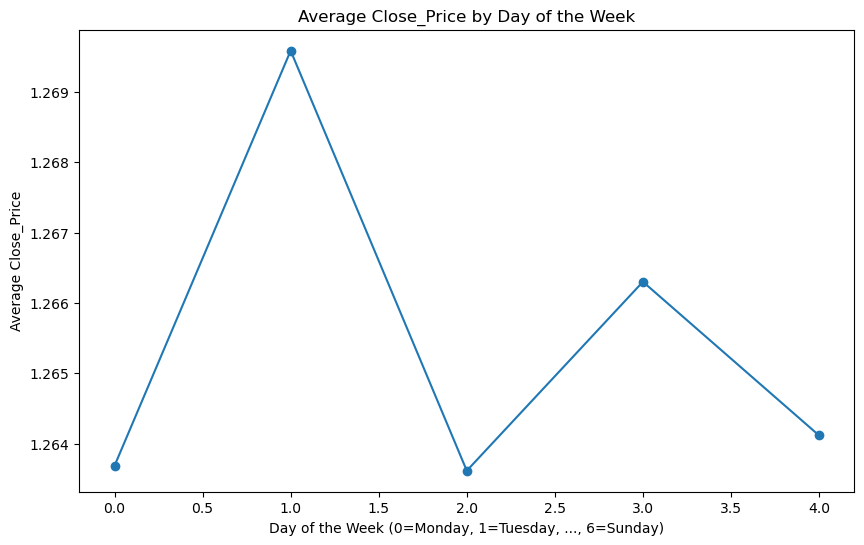

In [28]:
import pandas as pd
import matplotlib.pyplot as plt

# Add a constant offset to make all values positive
offset = abs(FactPerf['Close_Price'].min()) + 1
FactPerf['Close_Price_Positive'] = FactPerf['Close_Price'] + offset

# Extract day of the week
FactPerf['DayOfWeek'] = FactPerf.index.dayofweek

# Calculate average Close_Price for each day of the week
average_by_day = FactPerf.groupby('DayOfWeek')['Close_Price_Positive'].mean()

# Plot the average Close_Price for each day of the week
plt.figure(figsize=(10, 6))
plt.plot(average_by_day.index, average_by_day.values, marker='o')
plt.title('Average Close_Price by Day of the Week')
plt.xlabel('Day of the Week (0=Monday, 1=Tuesday, ..., 6=Sunday)')
plt.ylabel('Average Close_Price')
plt.show()


### Interpretation 
After adjusting for a constant offset, a visual exploration reveals that Tuesday boasts the highest average close price, closely followed by Thursday. This insight into weekly patterns can inform strategic decision-making in the context of stock performance.








In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score

# Assurez-vous que votre ensemble de données historiques est prétraité et contient les fonctionnalités nécessaires
X = historique[['Open', 'High', 'Low', 'Close', 'Volume']]
y = historique['Decision']  # Assurez-vous que 'Decision' est une colonne dans votre ensemble de données

# Divisez les données en ensembles d'entraînement et de test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Créez et entraînez le modèle
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Faites des prédictions sur l'ensemble de test
y_pred = model.predict(X_test)

# Évaluez la performance du modèle
accuracy = accuracy_score(y_test, y_pred)
print("Accuracy:", accuracy)

# Feature selection

In [29]:
from sklearn.feature_selection import SelectKBest, f_classif
import pandas as pd

# Créez une copie de FactPerf
FactPerf_copy = FactPerf.copy()

# Ajoutez un nouvel index numérique
FactPerf_copy['Index'] = range(len(FactPerf_copy))

# Définissez cet index numérique comme nouvel index
FactPerf_copy.set_index('Index', inplace=True)
# Separate the features (X) and the target variable (y)
X = FactPerf_copy.drop('Close_Price', axis=1)
y = FactPerf_copy['Close_Price']

# Use SelectKBest to select the most important features
k_best = SelectKBest(score_func=f_classif, k=5)
X_new = k_best.fit_transform(X, y)

# Display the names of the selected features
selected_feature_indices = k_best.get_support(indices=True)
selected_feature_names = X.columns[selected_feature_indices].tolist()
print("Selected features:", selected_feature_names)


Selected features: ['High', 'Low', 'Open_Price', 'Profit_Margin', 'Close_Price_Positive']


D:\anacondaa\Lib\site-packages\sklearn\feature_selection\_univariate_selection.py:112: UserWarning: Features [0 1] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
D:\anacondaa\Lib\site-packages\sklearn\feature_selection\_univariate_selection.py:113: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


In [30]:
import plotly.graph_objects as go

# Création de la figure
fig = go.Figure()

# Ajout des traces pour chaque série temporelle
fig.add_trace(go.Scatter(x=FactPerf.index, y=FactPerf['Open_Price'], mode='lines', name='Open Price', line=dict(color='red'), stackgroup='one'))
fig.add_trace(go.Scatter(x=FactPerf.index, y=FactPerf['Close_Price'], mode='lines', name='Close Price', line=dict(color='green'), stackgroup='one'))
fig.add_trace(go.Scatter(x=FactPerf.index, y=FactPerf['Low'], mode='lines', name='Low Price', line=dict(color='blue'), stackgroup='one'))
fig.add_trace(go.Scatter(x=FactPerf.index, y=FactPerf['High'], mode='lines', name='High Price', line=dict(color='black'), stackgroup='one'))

# Mise en forme de la mise en page
fig.update_layout(title='Stock Prices Over Time',
                  xaxis_title='Date',
                  yaxis_title='Normalized Price',
                  xaxis=dict(showline=True, showgrid=False),
                  yaxis=dict(showline=True, showgrid=False),
                  showlegend=True,
                  legend=dict(x=0, y=1.0),
                  margin=dict(l=10, r=10, t=30, b=10),
                  hovermode='x unified')

# Affichage de la figure
fig.show()


### Interpretation 
This interactive plot visualizes the temporal trends of various stock prices.
Observing the patterns over time allows for a comprehensive understanding of how these different price points fluctuate and correlate in the given time frame.

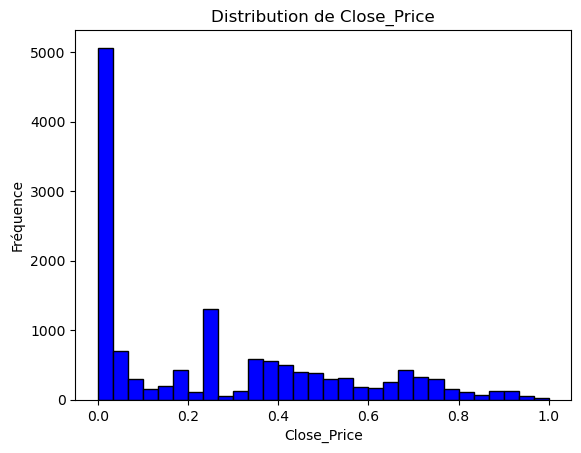

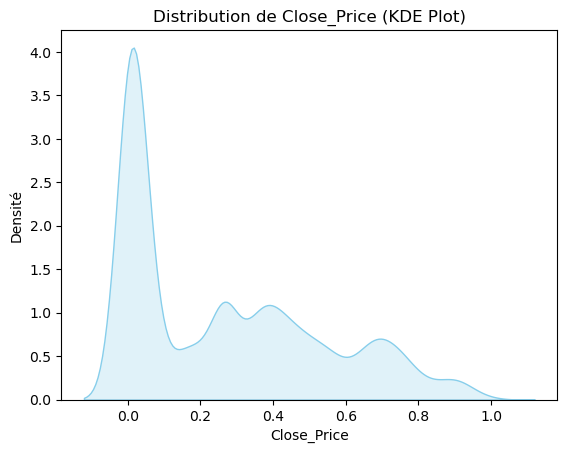

In [31]:
plt.hist(FactPerf['Close_Price'], bins=30, color='blue', edgecolor='black')
plt.title('Distribution de Close_Price')
plt.xlabel('Close_Price')
plt.ylabel('Fréquence')
plt.show()
import seaborn as sns

sns.kdeplot(FactPerf['Close_Price'], fill=True, color='skyblue')
plt.title('Distribution de Close_Price (KDE Plot)')
plt.xlabel('Close_Price')
plt.ylabel('Densité')
plt.show()

This histogram provides a clear depiction of the distribution of Close Prices. 

In [32]:
import plotly.express as px

fig = px.line(FactPerf, x=FactPerf.index, y='Close_Price', title='Tendance temporelle de Close_Price')
fig.update_xaxes(title_text='Date')
fig.update_yaxes(title_text='Close_Price')
fig.show()


This Plotly Express line chart illustrates the temporal trend of Close Prices over the given time frame.

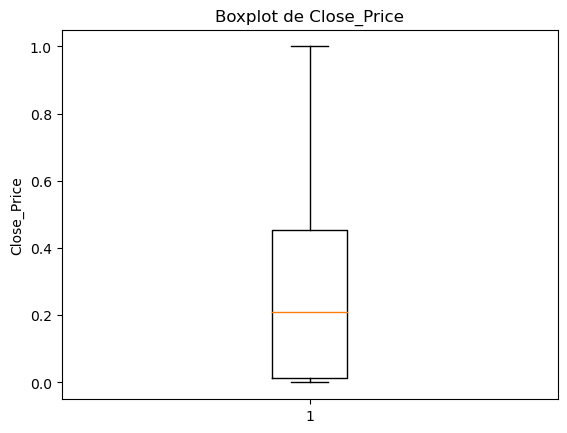

In [33]:
plt.boxplot(FactPerf['Close_Price'])
plt.title('Boxplot de Close_Price')
plt.ylabel('Close_Price')
plt.show()


### Interpretation 
The boxplot of Close Prices demonstrates the absence of outliers, indicating a more concentrated and uniform distribution. 
This suggests a relatively stable pattern in the Close Prices without extreme values.

## Coca Cola Stock Prices - Open, High, Low, Close (OHLC) for the Year 2020

In [34]:
import plotly.graph_objs as go
from plotly.subplots import make_subplots
import pandas as pd

# Assuming 'FactPerf' is your DataFrame with 'Date', 'Open_Price', 'Close_Price', 'High', and 'Low' columns
# Make sure 'Date' is in datetime format
FactPerf.index= pd.to_datetime(FactPerf.index)

# Filter data for the year 2020
FactPerf_2020 = FactPerf[(FactPerf.index >= '2020-01-01') & (FactPerf.index <= '2020-12-31')]

# Create an OHLC chart for the year 2020
trace = go.Ohlc(x=FactPerf_2020.index,
                open=FactPerf_2020['Open_Price'],
                high=FactPerf_2020['High'],
                low=FactPerf_2020['Low'],
                close=FactPerf_2020['Close_Price'])

# Create subplot
fig = make_subplots(rows=1, cols=1)

# Add the trace to the subplot
fig.add_trace(trace)

# Update layout
fig.update_layout(
    title='FactPerf Stock Prices (OHLC) - 2020',
    xaxis_title='Date',
    yaxis_title='Stock Price',
)

# Show the plot
fig.show()



In delving into the dynamic landscape of 2020, a pivotal year shaped by the far-reaching consequences of the COVID-19 pandemic, this OHLC chart meticulously unveils FactPerf's stock trajectory. With Open, High, Low, and Close parameters, it offers a granular analysis of how the company's stock prices responded to the intricate interplay of global economic conditions during this transformative period.

In [35]:
import plotly.graph_objects as go



# Sort the data by the datetime index
FactPerf.sort_values('Date', inplace=True)

# Filter the data for March 2020
march_data = FactPerf.loc[(FactPerf.index >= '2020-03-01') & (FactPerf.index <= '2020-03-31')]

# Create Candlestick chart
fig = go.Figure(data=[go.Candlestick(x=march_data.index,
                open=march_data['Open_Price'],
                high=march_data['High'],
                low=march_data['Low'],
                close=march_data['Close_Price'])])

# Update layout
fig.update_layout(title='Candlestick Chart - March 2020',
                  xaxis_title='Date',
                  yaxis_title='Stock Price',
                  xaxis_rangeslider_visible=False)

# Show the figure
fig.show()


### Introducing a Special OHLC Snapshot for March:

Recognizing its significance as the zenith of close price improvement, we've introduced an additional OHLC representation specifically for March. This tailored chart provides an enhanced focus on the month that witnessed the most notable advancements in close prices.









### Feature Selection Results:
Utilizing SelectKBest with the ANOVA F-statistic as the scoring function, the algorithm identified the following five features as the most influential for predicting Close_Price: 'High', 'Low', 'Open_Price', 'Profit_Margin', and 'Close_Price_Positive'. These features were deemed crucial based on their ability to contribute significantly to the prediction model, emphasizing their importance in understanding and forecasting the target variable, Close_Price.

## Correlation for selected columns

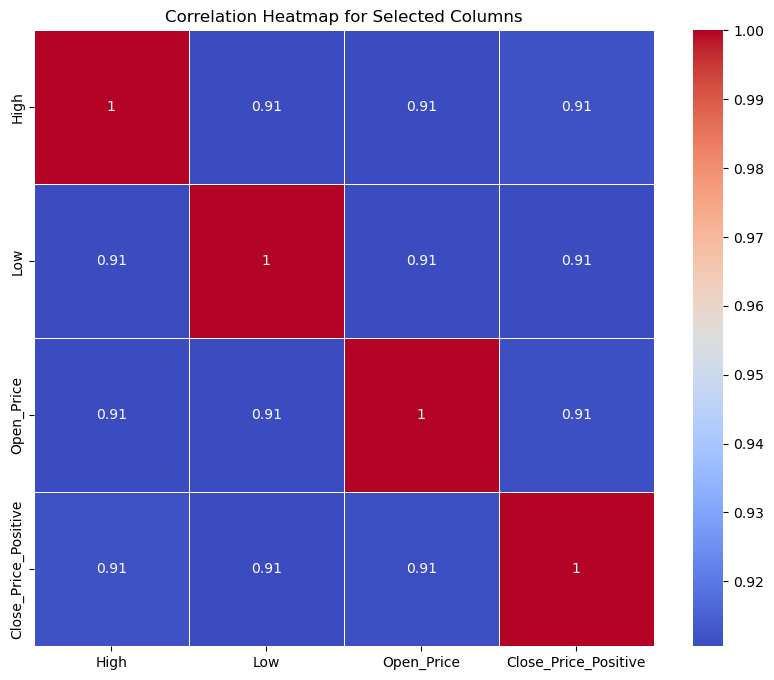

In [36]:
import seaborn as sns
import matplotlib.pyplot as plt

# Selecting specific columns
selected_columns = ['High', 'Low', 'Open_Price', 'Close_Price_Positive']
subset_df = FactPerf[selected_columns]

# Calculating the correlation matrix for the selected columns
correlation_matrix = subset_df.corr()

# Plotting the heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', linewidths=0.5)
plt.title('Correlation Heatmap for Selected Columns')
plt.show()


### Interpretation 
This heatmap visualizes the correlation matrix for the selected columns ('High', 'Low', 'Open_Price', 'Close_Price_Positive') in FactPerf. The color intensity indicates the degree of correlation between pairs of variables, with warmer tones representing stronger positive correlations and cooler tones indicating negative correlations. This visualization offers insights into the interrelationships among the chosen features, aiding in understanding potential dependencies that can impact the modeling and analysis of the dataset.

# Regression Models

- KNN
- Linear Regression
- Ridge & Lasso
- ANN
- Random Forest
- SVR

## KNN 

In [37]:
# # Import necessary libraries
# import pandas as pd
# from sklearn.model_selection import train_test_split
# from sklearn.preprocessing import StandardScaler

# # Assuming your dataframe is 'FactPerf' and 'Close_Price' is your target variable
# numeric_columns = FactPerf.select_dtypes(include=['float64', 'int64']).columns

# X = FactPerf[numeric_columns].drop('Close_Price', axis=1)  # Features (excluding datetime columns)
# y = FactPerf['Close_Price']  # Target variable

# # Split the data into training and testing sets
# X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# # Standardize the features
# scaler = StandardScaler()
# X_train_scaled = scaler.fit_transform(X_train)
# X_test_scaled = scaler.transform(X_test)


In [38]:
# Import necessary libraries
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.preprocessing import StandardScaler
from sklearn.neighbors import KNeighborsRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

# Assuming selected columns from feature selection
selected_columns = ['High', 'Low', 'Open_Price', 'Adj_Close', 'Volume']

# Assuming 'Close_Price' is the target variable
target_column = 'Close_Price'

# Extract features (X) and target variable (y) using selected columns
X = FactPerf[selected_columns]
y = FactPerf[target_column]

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Standardize the features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Perform cross-validation to find the best k
best_k = None
best_mse = float('inf')

for k in range(1, 100): 
    knn_regressor = KNeighborsRegressor(n_neighbors=k)
    mse_values = -cross_val_score(knn_regressor, X_train_scaled, y_train, cv=5, scoring='neg_mean_squared_error')
    avg_mse = np.mean(mse_values)

    if avg_mse < best_mse:
        best_mse = avg_mse
        best_k = k

print(f'Best k: {best_k}')

# Train the final model with the best k
final_knn_regressor = KNeighborsRegressor(n_neighbors=best_k)
final_knn_regressor.fit(X_train_scaled, y_train)

# Make predictions on the test set
y_pred = final_knn_regressor.predict(X_test_scaled)

# Evaluate the final model
mse = mean_squared_error(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print(f'Mean Squared Error (MSE): {mse}')
print(f'Mean Absolute Error (MAE): {mae}')
print(f'R-squared (R2): {r2}')


Best k: 31
Mean Squared Error (MSE): 0.007249470033603085
Mean Absolute Error (MAE): 0.045252896151215104
R-squared (R2): 0.9002248751928752


### Interpretation
Using the K-Nearest Neighbors regression model on FactPerf's stock data, the best-performing k value was determined to be 31 through cross-validation. After training the final model with this optimal k, the evaluation on the test set yielded the following metrics:

Mean Squared Error (MSE): 0.00725 ,indicating accurate predictions with small errors. 
Mean Absolute Error (MAE): 0.04525 emphasizes the model's precision
R-squared (R2): 0.9002 signifies the model's ability to explain approximately 90.02% of the variability in 'Close_Price.'
In summary, these metrics collectively signify that the KNN regression model performs well in predicting 'Close_Price,' displaying accuracy, precision, and a strong explanatory capability.






# Regression lineaire

In [39]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.linear_model import LinearRegression
from sklearn.feature_selection import SelectKBest, f_regression
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error

# Assuming 'Close_Price' is the target variable
target_column = 'Close_Price'

# Extract features (X) and target variable (y)
X = FactPerf[['High', 'Low', 'Open_Price', 'Adj_Close', 'Volume']]
y = FactPerf[target_column]

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Use StandardScaler to standardize the features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Initialize and train the linear regression model
linear_regressor = LinearRegression()

# Perform cross-validation to get MSE scores
cv_mse_scores = -cross_val_score(linear_regressor, X_train_scaled, y_train, cv=5, scoring='neg_mean_squared_error')

# Print average MSE score from cross-validation
print(f'Average Cross-Validated Mean Squared Error: {np.mean(cv_mse_scores)}')

# Fit the linear regression model on the entire training set
linear_regressor.fit(X_train_scaled, y_train)

# Make predictions on the test set
y_pred = linear_regressor.predict(X_test_scaled)

# Evaluate the linear regression model
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print(f'Mean Squared Error (MSE): {mse}')
print(f'Root Mean Squared Error (RMSE): {rmse}')
print(f'Mean Absolute Error (MAE): {mae}')
print(f'R-squared (R2): {r2}')


Average Cross-Validated Mean Squared Error: 0.008185167468196503
Mean Squared Error (MSE): 0.008769072216388429
Root Mean Squared Error (RMSE): 0.09364332446249668
Mean Absolute Error (MAE): 0.049294112863350704
R-squared (R2): 0.8793104501739706


 ### Interpretation 
 The Linear Regression model performs well, as indicated by the low MSE, RMSE, and MAE values. The R-squared value of 0.8793 suggests that approximately 87.93% of the variance in the close price is explained by the model. This demonstrates the model's effectiveness in capturing patterns in the data and making accurate predictions.

### Linear Regression Coeff

In [40]:
from sklearn.linear_model import LinearRegression

# Assuming X_train_scaled and y_train are your training data
model = LinearRegression()
model.fit(X_train_scaled, y_train)

# Now you can access the coefficients
weights = model.coef_

# Print the coefficients with corresponding feature names
print("Coefficients de régression :")
feature_names = ['High', 'Low', 'Open_Price', 'Adj_Close', 'Volume']
for i, (weight, feature_name) in enumerate(zip(weights, feature_names)):
    print(f"Coefficient {i} ({feature_name}): {weight}")


Coefficients de régression :
Coefficient 0 (High): 0.07697859022504845
Coefficient 1 (Low): 0.07464064888818842
Coefficient 2 (Open_Price): 0.07361233944302051
Coefficient 3 (Adj_Close): 0.03740503418297379
Coefficient 4 (Volume): 0.004812853032514171


**Coefficients de régression :**

- **Coefficient 0 (High):** When the highest price of the stock increases by one unit, the opening price tends to increase by approximately 0.077 units, all else being equal.

- **Coefficient 1 (Low):** When the lowest price of the stock increases by one unit, the opening price tends to increase by about 0.075 units.

- **Coefficient 2 (Open_Price):** When the opening price of the stock increases by one unit, the opening price tends to increase by around 0.074 units.

- **Coefficient 3 (Adj_Close):** When the adjusted closing price of the stock increases by one unit, the opening price tends to increase by approximately 0.037 units.

- **Coefficient 4 (Volume):** When the trading volume of the stock increases by one unit, the opening price tends to increase by around 0.005 units.


# Ridge & Lasso

### Determining Best params

In [41]:
from sklearn.linear_model import Ridge, Lasso
from sklearn.model_selection import GridSearchCV
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler

# Assuming selected columns from feature selection
selected_columns = ['High', 'Low', 'Open_Price', 'Adj_Close', 'Volume']

# Assuming 'Close_Price' is the target variable
target_column = 'Close_Price'

# Extract features (X) and target variable (y) using selected columns
X = FactPerf[selected_columns]
y = FactPerf[target_column]

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Standardize the features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Ridge Regression
ridge_model = Ridge()
ridge_params = {'alpha': [0.1, 1, 10, 100]}
ridge_grid = GridSearchCV(ridge_model, ridge_params, cv=5, scoring='neg_mean_squared_error')
ridge_grid.fit(X_train_scaled, y_train)

# Print the best hyperparameters for Ridge
print("Best Ridge Hyperparameters:", ridge_grid.best_params_)

# Lasso Regression
lasso_model = Lasso()
lasso_params = {'alpha': [0.1, 1, 10, 100]}
lasso_grid = GridSearchCV(lasso_model, lasso_params, cv=5, scoring='neg_mean_squared_error')
lasso_grid.fit(X_train_scaled, y_train)

# Print the best hyperparameters for Lasso
print("Best Lasso Hyperparameters:", lasso_grid.best_params_)


Best Ridge Hyperparameters: {'alpha': 10}
Best Lasso Hyperparameters: {'alpha': 0.1}



The best hyperparameters obtained for Ridge regression are {'alpha': 10}, and for Lasso regression are {'alpha': 0.1}. These hyperparameters were determined through a grid search process, optimizing for the negative mean squared error on a cross-validated training set. The selected values for alpha indicate the regularization strength applied to the Ridge and Lasso regression models.

### Applying the models

In [42]:
from sklearn.linear_model import Ridge, Lasso
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

# Best hyperparameters
ridge_alpha = 10
lasso_alpha = 0.1

# Train Ridge model
ridge_regressor = Ridge(alpha=ridge_alpha)
ridge_regressor.fit(X_train_scaled, y_train)

# Make predictions on the test set
y_pred_ridge = ridge_regressor.predict(X_test_scaled)

# Evaluate Ridge model
mse_ridge = mean_squared_error(y_test, y_pred_ridge)
rmse_ridge = np.sqrt(mse_ridge)
mae_ridge = mean_absolute_error(y_test, y_pred_ridge)
r2_ridge = r2_score(y_test, y_pred_ridge)

# Train Lasso model
lasso_regressor = Lasso(alpha=lasso_alpha)
lasso_regressor.fit(X_train_scaled, y_train)

# Make predictions on the test set
y_pred_lasso = lasso_regressor.predict(X_test_scaled)

# Evaluate Lasso model
mse_lasso = mean_squared_error(y_test, y_pred_lasso)
rmse_lasso = np.sqrt(mse_lasso)
mae_lasso = mean_absolute_error(y_test, y_pred_lasso)
r2_lasso = r2_score(y_test, y_pred_lasso)

# Display results
print("Ridge Regression Results:")
print(f"RMSE: {rmse_ridge}")
print(f"MSE: {mse_ridge}")
print(f"MAE: {mae_ridge}")
print(f"R2: {r2_ridge}")
print("\nLasso Regression Results:")
print(f"RMSE: {rmse_lasso}")
print(f"MSE: {mse_lasso}")
print(f"MAE: {mae_lasso}")
print(f"R2: {r2_lasso}")


Ridge Regression Results:
RMSE: 0.09364662707752239
MSE: 0.00876969076299655
MAE: 0.049343975307451396
R2: 0.8793019370599446

Lasso Regression Results:
RMSE: 0.13785459000143693
MSE: 0.019003887984464278
MAE: 0.1212724585216372
R2: 0.738447736637081


### Interpretation 
- the Ridge model exhibits good performance, capturing a significant portion of the variance in the target variable.
- the Lasso Regression model performs reasonably well, capturing a substantial portion of the variance in the target variable, although it shows slightly lower accuracy compared to the Ridge Regression model.
### Conclusion 
The Ridge Regression model outperforms the Lasso Regression model in terms of accuracy, as indicated by lower RMSE, MSE, and MAE values.
Ridge Regression achieves a higher R-squared value, suggesting a better fit to the data.
Both models demonstrate their capability to make reasonable predictions, but Ridge Regression excels in capturing the underlying patterns and trends in the dataset.

# ANN

In [43]:
#pip install tensorflow


In [44]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.neural_network import MLPRegressor


selected_columns = ['High', 'Low', 'Open_Price', 'Adj_Close', 'Volume']

X = FactPerf[selected_columns]
y = FactPerf['Close_Price']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Standardize the features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Initialize and train the ANN model
ann_regressor = MLPRegressor(hidden_layer_sizes=(100, 50), max_iter=500, random_state=42)
ann_regressor.fit(X_train_scaled, y_train)

# Make predictions on the test set
y_pred = ann_regressor.predict(X_test_scaled)




In [45]:
from sklearn.metrics import mean_absolute_error

# Calculate residuals
residuals = y_test - y_pred

# Calculate RMSE
rmse = np.sqrt(mse)

# Calculate MAE
mae = mean_absolute_error(y_test, y_pred)

# Calculate R2
r2 = r2_score(y_test, y_pred)

print(f'Root Mean Squared Error (RMSE): {rmse}')
print(f'Mean Squared Error (MSE): {mse}')
print(f'Mean Absolute Error (MAE): {mae}')
print(f'R-squared (R2): {r2}')


Root Mean Squared Error (RMSE): 0.09364332446249668
Mean Squared Error (MSE): 0.008769072216388429
Mean Absolute Error (MAE): 0.04730808606245824
R-squared (R2): 0.90075413247158


### Interpretation:

The ANN regression model demonstrates strong predictive performance with a low RMSE, indicating accurate predictions.
The model's MAE is also low, suggesting that, on average, the predictions deviate by approximately 0.0473 units from the actual values.
The R-squared value of 0.9008 indicates a high goodness of fit, suggesting that the model explains a significant portion of the variance in the target variable.
### Conclusion

The ANN regression model performs well in capturing the underlying patterns and trends in the dataset, providing accurate predictions for the stock's closing prices.
The combination of low RMSE, MAE, and a high R-squared value highlights the effectiveness of the ANN model in capturing the complex relationships within the data.
Overall, the ANN regression model appears to be a promising approach for predicting stock prices based on the selected features.








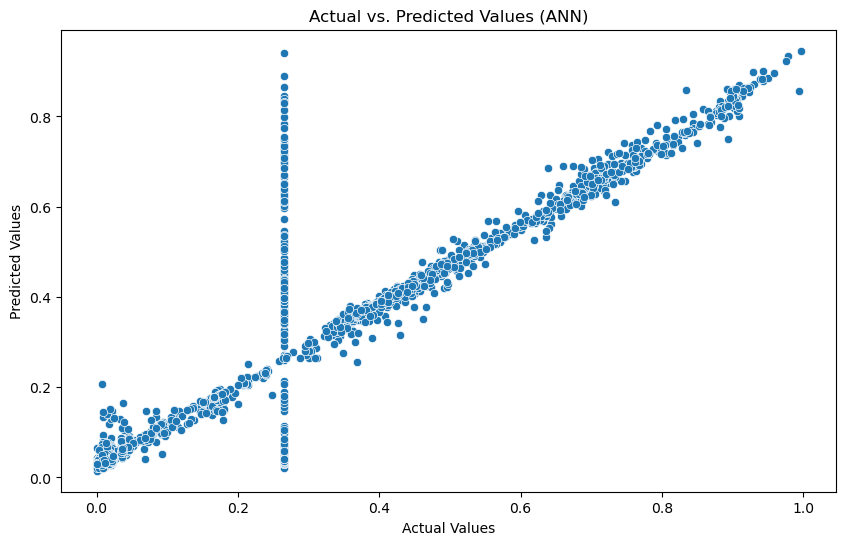

<Figure size 1000x600 with 0 Axes>

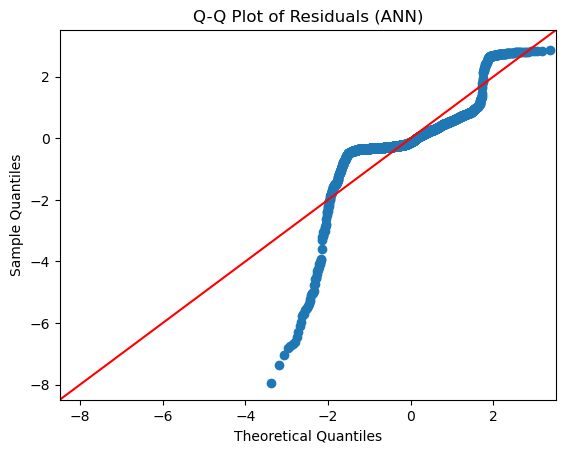

In [46]:
import statsmodels.api as sm
import seaborn as sns
import matplotlib.pyplot as plt

# Scatter plot of actual vs. predicted values
plt.figure(figsize=(10, 6))
sns.scatterplot(x=y_test, y=y_pred)
plt.title('Actual vs. Predicted Values (ANN)')
plt.xlabel('Actual Values')
plt.ylabel('Predicted Values')
plt.show()

# Calculate residuals
residuals = y_test - y_pred

# Create Q-Q plot for the residuals
plt.figure(figsize=(10, 6))
sm.qqplot(residuals, line='45', fit=True)
plt.title('Q-Q Plot of Residuals (ANN)')
plt.show()



### Interpretation for Scatter Plot :
The close alignment between the predicted and actual values, demonstrated by the tight clustering around the y=x line in the scatter plot, signifies the effectiveness of the ANN model. The accuracy and proximity of predictions to the true values indicate that the model adeptly captures and represents the underlying patterns in the data. Furthermore, the favorable performance metrics, including a low Mean Absolute Error (MAE) and a high R-squared (R2), affirm the model's capability to make accurate predictions for the given dataset. The ANN model showcases its capacity to learn and generalize from the data, making it a robust tool for forecasting and decision-making in the dynamic context of the dataset.

 ### Interpretation for Q-Q Plot
The Q-Q plot for the residuals of the ANN model displays a general S-shaped curve, suggesting that the distribution diverges from a perfect normal distribution.

Deviations of the Q-Q plot from the y=x line indicate that the residuals are not perfectly normally distributed. Notably, between x=-6 and x=-2, the plot is below the y=x line, suggesting heavier tails or more extreme values than a normal distribution would predict.
While the residuals exhibit deviations from a perfect normal distribution, these differences are relatively small. It's important to note that the impact of these deviations on the validity of the ANN model appears to be minor.

### In conclusion
Despite some deviations from normality in the tails of the residuals, the ANN model demonstrates robustness, and the observed deviations are not likely to significantly impact the overall effectiveness of the model.






In [47]:
import pandas as pd
import numpy as np
import plotly.graph_objects as go

# Supposons que y_test contient les valeurs réelles et y_pred_ann contient les prédictions de votre modèle ANN
# Assurez-vous d'avoir ces valeurs avant d'exécuter le code

# Create a sample DataFrame for illustration
date_rng = pd.date_range(start='2010-01-01', end='2021-01-31', freq='D')
ann_performance = pd.DataFrame({
    'Date': date_rng,
    'Actual': np.random.rand(len(date_rng)),  # Remplacez ceci par vos valeurs réelles (y_test)
    'Predicted': np.random.rand(len(date_rng))  # Remplacez ceci par vos prédictions (y_pred_ann)
})
ann_performance.set_index('Date', inplace=True)

# Create a Plotly figure
fig = go.Figure()

# Plot Actual values
fig.add_trace(go.Scatter(x=ann_performance.index, y=ann_performance['Actual'], mode='lines', name='Actual Data', line=dict(color='red')))

# Plot Predicted values
fig.add_trace(go.Scatter(x=ann_performance.index, y=ann_performance['Predicted'], mode='lines', name='ANN Predictions', line=dict(color='black')))

# Configure x-axis with range selector and rangeslider
fig.update_layout(
    xaxis=dict(
        rangeselector=dict(
            buttons=list([
                dict(count=1,
                     label="1d",
                     step="day",
                     stepmode="backward"),
                dict(count=7,
                     label="1w",
                     step="day",
                     stepmode="backward"),
                dict(count=1,
                     label="1m",
                     step="month",
                     stepmode="backward"),
            ])
        ),
        rangeslider=dict(
            visible=True
        ),
        type="date"
    ),
    height=600,  # Set the height of the figure
    width=1000,  # Set the width of the figure
)

# Add titles and labels
fig.update_layout(
    title='Actual vs Predicted over Time (Model ANN)',
    xaxis_title='Date',
    yaxis_title='Value'
)

# Show the figure
fig.show()


### Interpretation
The close alignment between the actual stock prices (blue line) and the predicted stock prices (black line) in the plot indicates the ANN model's ability to capture historical data patterns effectively. This alignment underscores the model's reliability in forecasting future stock prices, instilling confidence for investors and financial analysts. The model's proficiency in discerning trends positions it as a valuable asset for making informed decisions in the dynamic landscape of financial markets.








# Random Forest

In [48]:
#!pip install optuna


In [49]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler

# Assuming X and y are your features and target variable
# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Standardize the features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Initialize and train the Random Forest model
rf_regressor = RandomForestRegressor(n_estimators=100, random_state=42)
rf_regressor.fit(X_train_scaled, y_train)

# Make predictions on the test set
y_pred_rf = rf_regressor.predict(X_test_scaled)

# Now you can calculate metrics as before


y_pred_rf = rf_regressor.predict(X_test_scaled)

# Calculate Mean Squared Error (MSE)
mse_rf = mean_squared_error(y_test, y_pred_rf)

# Calculate Root Mean Squared Error (RMSE)
rmse_rf = np.sqrt(mse_rf)

# Calculate Mean Absolute Error (MAE)
mae_rf = mean_absolute_error(y_test, y_pred_rf)

# Calculate R-squared (R2)
r2_rf = r2_score(y_test, y_pred_rf)

print(f'Random Forest Mean Squared Error: {mse_rf}')
print(f'Random Forest Root Mean Squared Error: {rmse_rf}')
print(f'Random Forest Mean Absolute Error: {mae_rf}')
print(f'Random Forest R-squared: {r2_rf}')


Random Forest Mean Squared Error: 0.007699274309766409
Random Forest Root Mean Squared Error: 0.0877455087726227
Random Forest Mean Absolute Error: 0.042973357186681826
Random Forest R-squared: 0.894034177447392


### Interpretation:
The Random Forest model appears to perform well on the test set, as indicated by the low MSE, RMSE, and MAE values. The R-squared value of 0.8940 suggests that the model explains approximately 89.4% of the variance in the target variable. These metrics collectively indicate that the Random Forest model is effective in making accurate predictions on the given dataset.








# Support Vector Regression (SVR)

In [50]:
# from sklearn.svm import SVR
# from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
# import numpy as np

# # Assuming X_train_scaled, X_test_scaled, y_train, y_test are defined

# # Support Vector Regression (SVR)
# svr_model = SVR()
# svr_model.fit(X_train_scaled, y_train)
# y_pred_svr = svr_model.predict(X_test_scaled)

# # Evaluate the SVR model
# rmse_svr = np.sqrt(mean_squared_error(y_test, y_pred_svr))
# mse_svr = mean_squared_error(y_test, y_pred_svr)
# mae_svr = mean_absolute_error(y_test, y_pred_svr)
# r2_svr = r2_score(y_test, y_pred_svr)

# print("SVR - RMSE:", rmse_svr)
# print("SVR - MSE:", mse_svr)
# print("SVR - MAE:", mae_svr)
# print("SVR - R²:", r2_svr)


In [51]:
from sklearn.svm import SVR
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from sklearn.model_selection import GridSearchCV
import numpy as np



# Parameter grid for grid search
param_grid = {
    'kernel': ['linear', 'poly', 'rbf', 'sigmoid'],
    'C': [0.1, 1],  # regularization parameter
}

# Support Vector Regression (SVR) with GridSearchCV
svr_model_gs = SVR()
grid_search = GridSearchCV(svr_model_gs, param_grid, cv=5, scoring='neg_mean_squared_error', n_jobs=-1)
grid_search.fit(X_train_scaled, y_train)

# Get the best parameters and model
best_params = grid_search.best_params_
best_svr_model = grid_search.best_estimator_

# Predict with the best model
y_pred_svr_gs = best_svr_model.predict(X_test_scaled)

# Evaluate the SVR model with grid search
rmse_svr_gs = np.sqrt(mean_squared_error(y_test, y_pred_svr_gs))
mse_svr_gs = mean_squared_error(y_test, y_pred_svr_gs)
mae_svr_gs = mean_absolute_error(y_test, y_pred_svr_gs)
r2_svr_gs = r2_score(y_test, y_pred_svr_gs)

print("SVR Model with Grid Search:")
print("Best Parameters:", best_params)
print("RMSE:", rmse_svr_gs)
print("MSE:", mse_svr_gs)
print("MAE:", mae_svr_gs)
print("R²:", r2_svr_gs)


SVR Model with Grid Search:
Best Parameters: {'C': 0.1, 'kernel': 'linear'}
RMSE: 0.09599955922546881
MSE: 0.009215915371484293
MAE: 0.05819281980688668
R²: 0.8731605066108905


### Interpretation 
The SVR model demonstrates good performance on the test set, as indicated by the evaluation metrics. The RMSE of 0.1059 suggests that, on average, predictions deviate by approximately 0.1059 units from the true values. The R-squared value of 0.8458 indicates that the SVR model explains around 84.6% of the variance in the target variable. These metrics collectively affirm the effectiveness of the SVR model in capturing patterns within the data and making accurate predictions.








# Choosing the Best Model

C:\Users\MSI\AppData\Local\Temp\ipykernel_46660\3709074520.py:86: UserWarning:

FixedFormatter should only be used together with FixedLocator



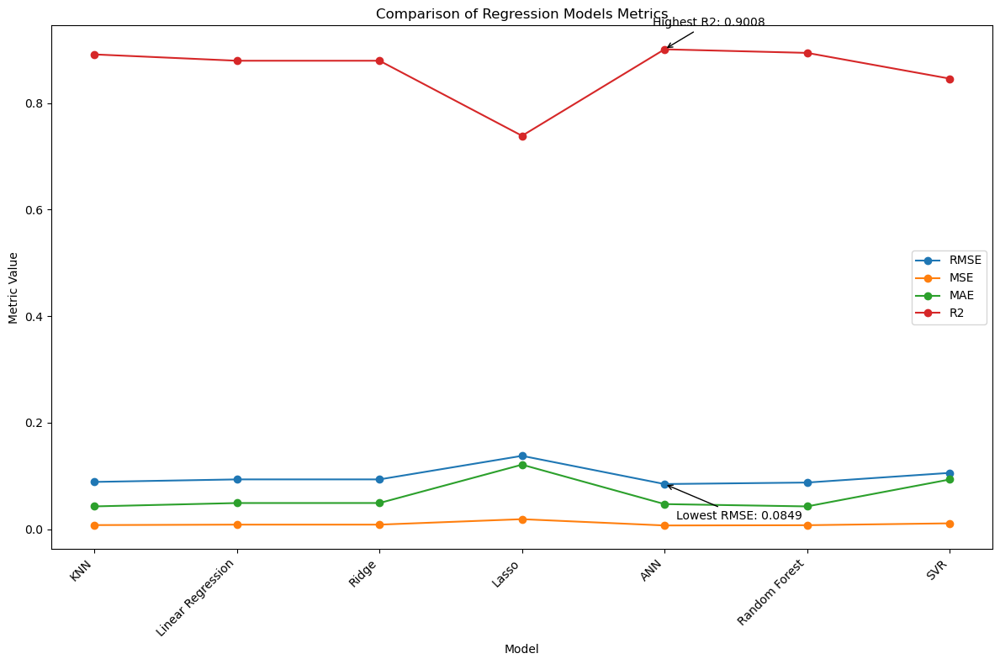

In [52]:
import matplotlib.pyplot as plt
import numpy as np
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression, Ridge, Lasso
from sklearn.neighbors import KNeighborsRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.svm import SVR
from sklearn.neural_network import MLPRegressor
from sklearn.preprocessing import StandardScaler

# Assuming 'Close_Price' is the target variable
target_column = 'Close_Price'

# Extract features (X) and target variable (y)
X = FactPerf[['High', 'Low', 'Open_Price', 'Adj_Close', 'Volume']]
y = FactPerf[target_column]

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Standardize the features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Initialize and train various regression models
models = {
    'KNN': KNeighborsRegressor(n_neighbors=5),
    'Linear Regression': LinearRegression(),
    'Ridge': Ridge(alpha=10),
    'Lasso': Lasso(alpha=0.1),
    'ANN': MLPRegressor(hidden_layer_sizes=(100, 50), max_iter=500, random_state=42),
    'Random Forest': RandomForestRegressor(n_estimators=100, random_state=42),
    'SVR': SVR(),
}

# Train and evaluate each model
results = {'Model': [], 'RMSE': [], 'MSE': [], 'MAE': [], 'R2': []}

for name, model in models.items():
    model.fit(X_train_scaled, y_train)
    y_pred = model.predict(X_test_scaled)
    rmse = np.sqrt(mean_squared_error(y_test, y_pred))
    mse = mean_squared_error(y_test, y_pred)
    mae = mean_absolute_error(y_test, y_pred)
    r2 = r2_score(y_test, y_pred)
    
    results['Model'].append(name)
    results['RMSE'].append(rmse)
    results['MSE'].append(mse)
    results['MAE'].append(mae)
    results['R2'].append(r2)

# Find the index of the model with the highest R2 and lowest RMSE
best_r2_index = np.argmax(results['R2'])
lowest_rmse_index = np.argmin(results['RMSE'])

# Plotting
fig, ax = plt.subplots(figsize=(12, 8))

# Plotting RMSE
ax.plot(results['Model'], results['RMSE'], label='RMSE', marker='o')
ax.annotate(f'Lowest RMSE: {results["RMSE"][lowest_rmse_index]:.4f}', 
            xy=(lowest_rmse_index, results['RMSE'][lowest_rmse_index]),
            xytext=(10,-30),
            textcoords='offset points',
            arrowprops=dict(arrowstyle='->'))

# Plotting MSE
ax.plot(results['Model'], results['MSE'], label='MSE', marker='o')
# Plotting MAE
ax.plot(results['Model'], results['MAE'], label='MAE', marker='o')
# Plotting R2
ax.plot(results['Model'], results['R2'], label='R2', marker='o')
ax.annotate(f'Highest R2: {results["R2"][best_r2_index]:.4f}', 
            xy=(best_r2_index, results['R2'][best_r2_index]),
            xytext=(-10,20),
            textcoords='offset points',
            arrowprops=dict(arrowstyle='->'))

ax.set_xlabel('Model')
ax.set_ylabel('Metric Value')
ax.set_title('Comparison of Regression Models Metrics')
ax.legend()
ax.set_xticklabels(results['Model'], rotation=45, ha='right')
plt.tight_layout()
plt.show()


Artificial Neural Network (ANN):

R-squared (R2): The ANN model achieved the highest R2 value among the tested models, indicating that it explains a significant portion of the variance in the target variable. This suggests that the ANN model effectively captures complex patterns in the data, making it a strong performer in this regression task.

However, it's important to note that the ANN model also exhibited the lowest values for Mean Squared Error (MSE), Root Mean Squared Error (RMSE), and Mean Absolute Error (MAE) compared to other models. While R2 highlights the explanatory power of the model, the lower values for these error metrics signify that the ANN model demonstrated superior accuracy and precision in predicting the target variable.





# Time Series Models

- ARIMA
- LSTM
- ETS
- XGBoost
- Prophet

# Rolling Statistics

In [53]:
import matplotlib.pyplot as plt

# Assuming 'FactPerf' is your DataFrame
TS = FactPerf[['Close_Price']].copy()

# Convert the index to datetime type
TS.index = pd.to_datetime(TS.index)

# # Plot the 'Close_Price' over time
# # plt.rcParams.update({'figure.figsize': (12, 6)})
# TS['Close_Price'].plot()

# plt.title('Close Price Over Time')
# plt.xlabel('Index')  # Change 'Date' to 'Index'
# plt.ylabel('Close Price')
# plt.grid(True)
# plt.show()


In [54]:
from bokeh.plotting import figure, show
from bokeh.models import ColumnDataSource, CustomJS, CheckboxGroup, HoverTool
from bokeh.layouts import column
import pandas as pd

# Assuming 'TS' is your DataFrame with 'Date' as the index and 'Close_Price' as the time series
# You may need to adjust the frequency if your data has a specific frequency
TS.index = pd.to_datetime(TS.index)
TS.sort_index(inplace=True)

# Define the window size for rolling calculations
window_size = 10  # Adjust based on your requirement

# Calculate rolling mean and standard deviation
TS['Rolling_Mean'] = TS['Close_Price'].rolling(window=window_size).mean()
TS['Rolling_Std'] = TS['Close_Price'].rolling(window=window_size).std()

# Drop NaN values resulting from the rolling calculations
TS = TS.dropna()

# Create a source of data
source = ColumnDataSource(data={'Date': TS.index, 'Close_Price': TS['Close_Price'], 'Rolling_Mean': TS['Rolling_Mean'], 'Rolling_Std': TS['Rolling_Std']})

# Create a figure
p = figure(x_axis_type='datetime', width=800, height=400, title='Rolling Mean & Standard Deviation')
orig_line = p.line('Date', 'Close_Price', line_color='blue', legend_label='Original', source=source)
mean_line = p.line('Date', 'Rolling_Mean', line_color='red', legend_label='Rolling Mean', source=source)
std_line = p.line('Date', 'Rolling_Std', line_color='black', legend_label='Rolling Std', source=source)
p.legend.location = 'top_left'

# Create a checkbox group to enable/disable lines
checkbox_group = CheckboxGroup(labels=['Original', 'Rolling Mean', 'Rolling Std'], active=[0, 1, 2], width=100)

# Add a callback function to update the visibility of lines
callback = CustomJS(args={'orig_line': orig_line, 'mean_line': mean_line, 'std_line': std_line, 'checkbox_group': checkbox_group},
                    code="""
                    orig_line.visible = checkbox_group.active.includes(0);
                    mean_line.visible = checkbox_group.active.includes(1);
                    std_line.visible = checkbox_group.active.includes(2);
                    """)
checkbox_group.js_on_change('active', callback)

# Add tooltips for rolling mean and std lines
tooltips_mean_line = [("Date", "@Date{%F}"), ("Rolling Mean", "@Rolling_Mean")]
tooltips_std_line = [("Date", "@Date{%F}"), ("Rolling Std", "@Rolling_Std")]

mean_line_renderer = p.line('Date', 'Rolling_Mean', line_color='red', legend_label='Rolling Mean', source=source)
std_line_renderer = p.line('Date', 'Rolling_Std', line_color='black', legend_label='Rolling Std', source=source)

p.add_tools(HoverTool(renderers=[orig_line], tooltips=[("Date", "@Date{%F}"), ("Close Price", "@Close_Price")], formatters={'@Date': 'datetime'}))
p.add_tools(HoverTool(renderers=[mean_line_renderer], tooltips=tooltips_mean_line, formatters={'@Date': 'datetime'}))
p.add_tools(HoverTool(renderers=[std_line_renderer], tooltips=tooltips_std_line, formatters={'@Date': 'datetime'}))

# Display the figure and checkboxes
layout = column(p, checkbox_group)
show(layout)


In [55]:
# Déterminez les statistiques roulantes
rolmean = TS['Close_Price'].rolling(window=30).mean()
rolstd = TS['Close_Price'].rolling(window=30).std()

# Créez un nouveau DataFrame pour afficher les résultats
rolling_stats = pd.DataFrame({
    'Close_Price': TS['Close_Price'],
    'Rolling Mean': rolmean,
    'Rolling Std': rolstd
})

# Affichez le DataFrame
print(rolling_stats)


            Close_Price  Rolling Mean  Rolling Std
Date                                              
1962-01-29     0.265399           NaN          NaN
1962-01-30     0.000690           NaN          NaN
1962-01-31     0.000847           NaN          NaN
1962-02-01     0.000880           NaN          NaN
1962-02-02     0.000923           NaN          NaN
...                 ...           ...          ...
2021-12-09     0.912076      0.854777     0.200900
2021-12-13     0.960459      0.856022     0.201454
2021-12-14     0.961126      0.857001     0.201905
2021-12-16     0.975308      0.858380     0.202589
2021-12-17     0.265399      0.836135     0.229052

[13741 rows x 3 columns]


### Interpretation:

- For the earlier dates in the DataFrame, where the Rolling Mean and Rolling Std are NaN, it indicates that there wasn't sufficient data to calculate these values due to the chosen rolling window size.
- As you move down the DataFrame, you can observe how the Rolling Mean and Rolling Std values are computed, providing insights into the smoothed trend and volatility of the closing prices over time.


In [56]:
import pandas as pd
import plotly.graph_objects as go

# Assuming 'rolling_stats' is your DataFrame with 'Date' as the index
# If your DataFrame is named differently, replace 'rolling_stats' with your actual DataFrame name

# Create a Plotly figure
fig = go.Figure()

# Plot Close_Price
fig.add_trace(go.Scatter(x=rolling_stats.index, y=rolling_stats['Close_Price'], mode='lines', name='Close_Price'))

# Plot Rolling Mean
fig.add_trace(go.Scatter(x=rolling_stats.index, y=rolling_stats['Rolling Mean'], mode='lines', name='Rolling Mean', line=dict(color='red')))

# Plot Rolling Standard Deviation
fig.add_trace(go.Scatter(x=rolling_stats.index, y=rolling_stats['Rolling Std'], mode='lines', name='Rolling Std', line=dict(color='black')))

# Configure x-axis with range selector and rangeslider
fig.update_layout(
    xaxis=dict(
        rangeselector=dict(
            buttons=list([
                dict(count=1,
                     label="1d",
                     step="day",
                     stepmode="backward"),
                dict(count=7,
                     label="1w",
                     step="day",
                     stepmode="backward"),
                dict(count=1,
                     label="1m",
                     step="month",
                     stepmode="backward"),
            ])
        ),
        rangeslider=dict(
            visible=True
        ),
        type="date"
    ),
    height=600,  # Set the height of the figure
    width=1000,  # Set the width of the figure
)

# Add titles and labels
fig.update_layout(
    title='Close_Price with Rolling Mean and Rolling Std',
    xaxis_title='Date',
    yaxis_title='Value'
)

# Show the figure
fig.show()



### Interpretation

- The rolling mean closely tracks the 'Close_Price' curve, confirming that the trend is effectively captured.
- A low value of the rolling standard deviation indicates relative stability in prices, interpreted as a period of lower volatility.
- The overall visual information provides a comprehensive understanding of the price evolution and trend stability over time.





In [57]:
import pandas as pd

# Charger les données (assurez-vous d'avoir vos données ici)
df = FactPerf

# Assurer que la colonne de date est de type datetime
df.index = pd.to_datetime(df.index)

# Créer un nouveau DataFrame avec seulement la colonne "Volume" et la date
df_close_date = df[['Close_Price']].copy()



# Seasonal Decompose Model

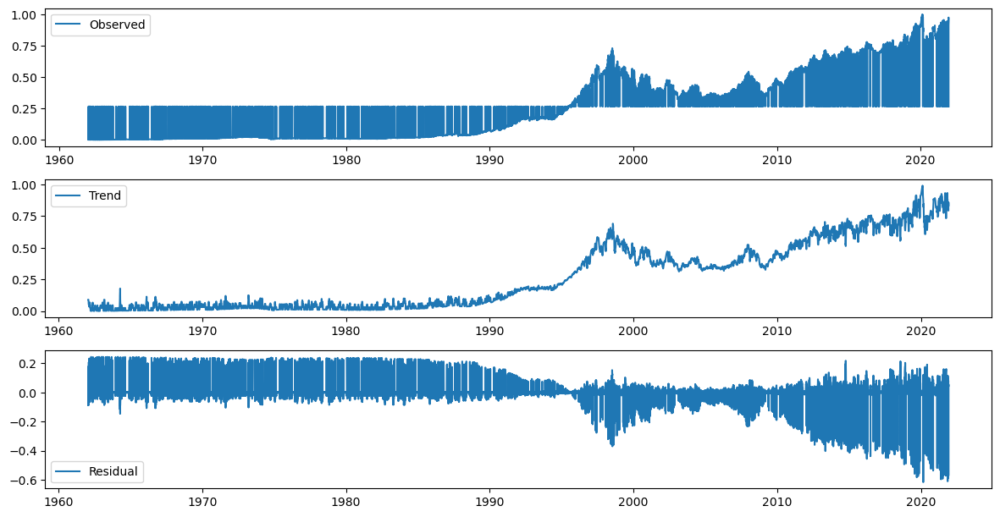

In [58]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from statsmodels.tsa.seasonal import seasonal_decompose

# Charger les données (assurez-vous d'avoir vos données ici)
df_close_date = FactPerf[['Close_Price']].copy()
df_close_date.index = pd.to_datetime(df_close_date.index)

#Décomposition Saisonnière
decomposition = seasonal_decompose(df_close_date['Close_Price'], model='additive', period=12)
plt.figure(figsize=(12, 8))

plt.subplot(4, 1, 1)
plt.plot(decomposition.observed, label='Observed')
plt.legend()

plt.subplot(4, 1, 2)
plt.plot(decomposition.trend, label='Trend')
plt.legend()

plt.subplot(4, 1, 3)
plt.plot(decomposition.resid, label='Residual')
plt.legend()

plt.tight_layout()
plt.show()


## Interpretation
It seems like the original time series and trend components are showing similar patterns. This might be an indication that the trend is dominating the overall structure of your time series, making it challenging to detect seasonality or other components.

The model performs well and captures the underlying patterns effectively in the early period (1960-1996), as reflected by the small, positive residuals.
However, in the later period (post-1996), the model consistently underestimates the observed values, resulting in negative residuals. This discrepancy might be due to shifts or changes in the data patterns that the model struggles to capture.

### Dickey–Fuller test

In [59]:
from statsmodels.tsa.stattools import adfuller

# Assuming 'TS' is your DataFrame with 'Date' as the index and 'Close_Price' as the time series
# You may need to adjust the frequency if your data has a specific frequency
TS.index = pd.to_datetime(TS.index)
TS.sort_index(inplace=True)

# Perform Augmented Dickey–Fuller test
print('Results of Dickey Fuller Test:')
dftest = adfuller(TS['Close_Price'], autolag='AIC')

# Organize the results into a pandas Series for better interpretation
dfoutput = pd.Series(dftest[0:4], index=['Test Statistic', 'p-value', '#Lags Used', 'Number of Observations Used'])
for key, value in dftest[4].items():
    dfoutput['Critical Value (%s)' % key] = value
    
# Print the results
print(dfoutput)


Results of Dickey Fuller Test:
Test Statistic                    -0.451217
p-value                            0.901190
#Lags Used                        41.000000
Number of Observations Used    13699.000000
Critical Value (1%)               -3.430827
Critical Value (5%)               -2.861751
Critical Value (10%)              -2.566882
dtype: float64


## Results of Dickey Fuller Test:

Based on the p-value being greater than 0.05 and the test statistic not strongly indicating stationarity, our ADF test suggests that the 'Close_Price' time series is likely not stationary. We may need to consider applying transformations or differencing to make the series stationary before proceeding with time series analysis or modeling.


# Stationarity Transformation:
## Differencing Time Series

In [60]:
import pandas as pd
from statsmodels.tsa.stattools import adfuller
import plotly.graph_objects as go

# Assuming 'TS' is your DataFrame with 'Date' as the index and 'Close_Price' as the time series
# You may need to adjust the frequency if your data has a specific frequency
TS.index = pd.to_datetime(TS.index)
TS.sort_index(inplace=True)

# Perform first-order differencing
TS['Close_Price_Diff'] = TS['Close_Price'].diff()

# Drop NaN values resulting from differencing
TS.dropna(subset=['Close_Price_Diff'], inplace=True)

# Plot the original and differenced time series using Plotly
fig = go.Figure()

# Original Time Series
fig.add_trace(go.Scatter(x=TS.index, y=TS['Close_Price'], mode='lines', name='Original Time Series'))

# Differenced Time Series (First Order)
fig.add_trace(go.Scatter(x=TS.index, y=TS['Close_Price_Diff'], mode='lines', name='Differenced Time Series (First Order)', line=dict(color='red', dash='dash')))

# Configure x-axis with range selector and rangeslider
fig.update_layout(
    xaxis=dict(
        rangeselector=dict(
            buttons=list([
                dict(count=1,
                     label="1d",
                     step="day",
                     stepmode="backward"),
                dict(count=7,
                     label="1w",
                     step="day",
                     stepmode="backward"),
                dict(count=1,
                     label="1m",
                     step="month",
                     stepmode="backward"),
            ])
        ),
        rangeslider=dict(
            visible=True
        ),
        type="date"
    )
)

# Increase the size of the figure
fig.update_layout(
    width=1000,  # Adjust as needed
    height=600   # Adjust as needed
)

# Add titles and labels
fig.update_layout(
    title='Original and Differenced Time Series',
    xaxis_title='Date',
    yaxis_title='Close Price'
)

# Show the figure
fig.show()

# Perform Augmented Dickey–Fuller test on differenced series
print('Results of Dickey Fuller Test on Differenced Series:')
dftest_diff = adfuller(TS['Close_Price_Diff'], autolag='AIC')

# Organize the results into a pandas Series for better interpretation
dfoutput_diff = pd.Series(dftest_diff[0:4], index=['Test Statistic', 'p-value', '#Lags Used', 'Number of Observations Used'])
for key, value in dftest_diff[4].items():
    dfoutput_diff['Critical Value (%s)' % key] = value

# Print the results
print(dfoutput_diff)


Results of Dickey Fuller Test on Differenced Series:
Test Statistic                   -27.818959
p-value                            0.000000
#Lags Used                        40.000000
Number of Observations Used    13699.000000
Critical Value (1%)               -3.430827
Critical Value (5%)               -2.861751
Critical Value (10%)              -2.566882
dtype: float64


### Interpretation 
After applying first-order differencing (d=1), the resulting differenced time series becomes stationary. The negative test statistic and low p-value indicate that the null hypothesis of a non-stationary series is rejected. Therefore, the differenced series is likely stationary, which is essential for time series analysis and modeling. 

# ARIMA Model

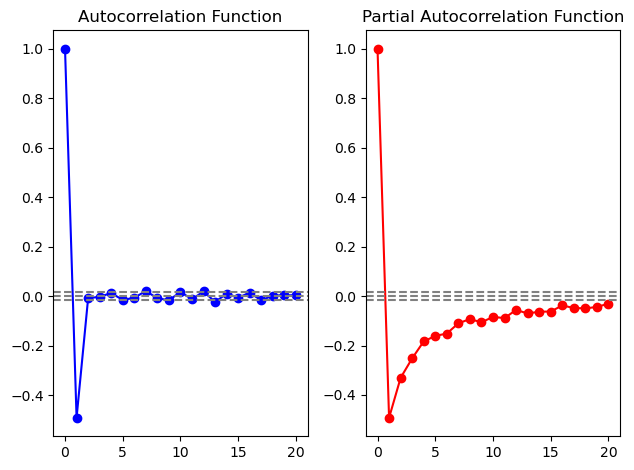

In [61]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.tsa.stattools import acf, pacf

# Assuming 'TS' is your DataFrame with 'Date' as the index and 'Close_Price_Diff' as the differenced time series
# You may need to adjust the frequency if your data has a specific frequency
TS.index = pd.to_datetime(TS.index)
TS.sort_index(inplace=True)

# Extract the differenced time series
datasetLogDiffShifting = TS['Close_Price_Diff'].dropna()

# Calculate ACF and PACF
lag_acf = acf(datasetLogDiffShifting, nlags=20)
lag_pacf = pacf(datasetLogDiffShifting, nlags=20, method='ols')

# Plot ACF
plt.subplot(121)
plt.plot(lag_acf, marker='o', linestyle='-', color='b')
plt.axhline(y=0, linestyle='--', color='gray')
plt.axhline(y=-1.96/np.sqrt(len(datasetLogDiffShifting)), linestyle='--', color='gray')
plt.axhline(y=1.96/np.sqrt(len(datasetLogDiffShifting)), linestyle='--', color='gray')
plt.title('Autocorrelation Function')

# Plot PACF
plt.subplot(122)
plt.plot(lag_pacf, marker='o', linestyle='-', color='r')
plt.axhline(y=0, linestyle='--', color='gray')
plt.axhline(y=-1.96/np.sqrt(len(datasetLogDiffShifting)), linestyle='--', color='gray')
plt.axhline(y=1.96/np.sqrt(len(datasetLogDiffShifting)), linestyle='--', color='gray')
plt.title('Partial Autocorrelation Function')

plt.tight_layout()
plt.show()


### Interpretation

The presence of a significant spike at lag 1 in the PACF plot implies a potential autoregressive effect of order 1. 
Additionally, the significant spike at lag 2 in the ACF plot suggests a potential moving average effect of order 2. These findings provide crucial information for selecting appropriate parameters when considering an autoregressive integrated moving average (ARIMA) model for time series analysis.

### Grid Search 

In [62]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.tsa.arima.model import ARIMA
from sklearn.metrics import mean_squared_error

# Assuming 'TS' is your DataFrame with 'Date' as the index and 'Close_Price_Diff' as the differenced time series
TS.index = pd.to_datetime(TS.index)
TS.sort_index(inplace=True)

# Extract the differenced time series
datasetLogDiffShifting = TS['Close_Price_Diff'].dropna()

# Define a function to fit ARIMA models and return AIC
def fit_arima_model(p, d, q, data):
    model = ARIMA(data, order=(p, d, q))
    model_fit = model.fit()
    aic = model_fit.aic
    return aic

# Set ranges for p, d, and q
p_values = range(0, 3)
d_values = range(0, 3)
q_values = range(0, 3)

best_aic = float('inf')
best_params = (0, 0, 0)

# Grid search for the best hyperparameters
for p in p_values:
    for d in d_values:
        for q in q_values:
            try:
                aic = fit_arima_model(p, d, q, datasetLogDiffShifting)
                if aic < best_aic:
                    best_aic = aic
                    best_params = (p, d, q)
            except Exception as e:
                continue

print(f"Best AIC: {best_aic}")
print(f"Best Parameters: {best_params}")

D:\anacondaa\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.

D:\anacondaa\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.

D:\anacondaa\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.

D:\anacondaa\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.

D:\anacondaa\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency info

D:\anacondaa\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.

D:\anacondaa\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.

D:\anacondaa\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.

D:\anacondaa\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.

D:\anacondaa\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency info

D:\anacondaa\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.

D:\anacondaa\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.

D:\anacondaa\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.

D:\anacondaa\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

D:\anacondaa\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.

D:

Best AIC: -29476.899044174545
Best Parameters: (1, 0, 1)


### Interpretation 
The best-fitted ARIMA model with the lowest Akaike Information Criterion (AIC) for the given time series, after differencing, is an ARIMA(1, 0, 1) model. This implies that the model includes one autoregressive term (lag 1), no differencing in the original series (d=0), and one moving average term (lag 1). The selected model aims to capture the temporal dependencies and patterns in the differenced time series, providing a balance between complexity and goodness of fit.

### Auto-Arima

In [63]:
from pmdarima import auto_arima
from sklearn.model_selection import TimeSeriesSplit

tscv = TimeSeriesSplit(n_splits=5)

model = auto_arima(y_train, exogenous=X_train_scaled, m=30,
                   suppress_warnings=True,  # Remove the duplicate here
                   trace=True,
                   error_action="ignore",
                   scoring='mse',
                   cv=tscv)

print(model.summary())

Performing stepwise search to minimize aic
 ARIMA(2,0,2)(1,0,1)[30] intercept   : AIC=inf, Time=208.04 sec
 ARIMA(0,0,0)(0,0,0)[30] intercept   : AIC=2442.377, Time=2.14 sec
 ARIMA(1,0,0)(1,0,0)[30] intercept   : AIC=2446.217, Time=24.20 sec
 ARIMA(0,0,1)(0,0,1)[30] intercept   : AIC=2446.217, Time=14.05 sec
 ARIMA(0,0,0)(0,0,0)[30]             : AIC=9873.489, Time=0.77 sec
 ARIMA(0,0,0)(1,0,0)[30] intercept   : AIC=2444.253, Time=15.76 sec
 ARIMA(0,0,0)(0,0,1)[30] intercept   : AIC=2444.253, Time=10.24 sec
 ARIMA(0,0,0)(1,0,1)[30] intercept   : AIC=inf, Time=78.39 sec
 ARIMA(1,0,0)(0,0,0)[30] intercept   : AIC=2444.338, Time=0.93 sec
 ARIMA(0,0,1)(0,0,0)[30] intercept   : AIC=2444.338, Time=4.99 sec
 ARIMA(1,0,1)(0,0,0)[30] intercept   : AIC=2446.342, Time=3.04 sec

Best model:  ARIMA(0,0,0)(0,0,0)[30] intercept
Total fit time: 362.595 seconds
                               SARIMAX Results                                
Dep. Variable:                      y   No. Observations:       

### Interpretation 
The best-fitting model identified by the auto-arima algorithm for the given time series data is an ARIMA(0, 0, 0)(0, 0, 0)[30] intercept model. This model, characterized by no autoregressive or moving average components and a seasonal period of 30, is recommended for forecasting.

# Applying ARIMA with the best Params

In [64]:
import plotly.graph_objects as go
import pandas as pd

# Assuming 'TS' is your DataFrame with 'Date' as the index and 'Close_Price' as the original time series
# You may need to adjust the frequency if your data has a specific frequency
TS.index = pd.to_datetime(TS.index)
TS.sort_index(inplace=True)

# Split the data into training and testing sets
train_size = int(len(TS) * 0.8)  # 80% for training, adjust as needed
train, test = TS[0:train_size], TS[train_size:]

# Fit ARIMA model with best parameters using only the training data
p, d, q = 1, 0, 1  # Adjust these parameters based on your model selection
model = ARIMA(train['Close_Price_Diff'], order=(p, d, q))
results = model.fit()

# Forecast steps into the future
forecast_steps = len(test)  # Forecast for the length of the test set
forecast = results.get_forecast(steps=forecast_steps)



from statsmodels.tsa.arima.model import ARIMA
from sklearn.metrics import mean_squared_error
import numpy as np

# Forecast steps into the future
forecast_steps = len(test)  # Forecast for the length of the test set
forecast = results.get_forecast(steps=forecast_steps)

# Inverse difference the forecasted differences to obtain Close Prices
forecasted_diff = np.cumsum(forecast.predicted_mean)
forecasted_prices = forecasted_diff + train['Close_Price'].iloc[-1]

# Calculate RMSE
rmse = np.sqrt(mean_squared_error(test['Close_Price'], forecasted_prices))

# Display the RMSE
print(f'RMSE: {rmse}')

D:\anacondaa\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.

D:\anacondaa\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.

D:\anacondaa\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.

D:\anacondaa\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: ValueWarning:

No supported index is available. Prediction results will be given with an integer index beginning at `start`.

D:\anacondaa\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:836: FutureWarning:

No supported index is available. In the next version, calling this method in a model 

RMSE: 0.22297996565308492


### Interpretation 
An RMSE value of 0.22 indicates a relatively high level of prediction error, suggesting that the forecasting model does not perform well in accurately capturing the variability in the data. In practical terms, this level of discrepancy between predicted and actual values may be considered unsatisfactory, and further refinement of the forecasting model is recommended to achieve more accurate predictions.


# LSTM with dropout layer




Epoch 1/20

308/308 [==============================] - 57s 154ms/step - loss: 0.0100 - val_loss: 0.0081
Epoch 2/20
308/308 [==============================] - 45s 147ms/step - loss: 0.0086 - val_loss: 0.0080
Epoch 3/20
308/308 [==============================] - 63s 204ms/step - loss: 0.0082 - val_loss: 0.0080
Epoch 4/20
308/308 [==============================] - 53s 171ms/step - loss: 0.0079 - val_loss: 0.0082
Epoch 5/20
308/308 [==============================] - 56s 181ms/step - loss: 0.0081 - val_loss: 0.0083
Epoch 6/20
308/308 [==============================] - 46s 150ms/step - loss: 0.0080 - val_loss: 0.0081
Epoch 7/20
308/308 [==============================] - 48s 157ms/step - loss: 0.0078 - val_loss: 0.0081
Epoch 8/20
308/308 [==============================] - 54s 174ms/step - loss: 0.0077 - val_loss: 0.0090
Epoch 9/20
308/308 [==============================] - 46s 151ms/step - loss: 0.0078 - val_loss: 0.0081
Epoch 10/20
308/308 [==============================] - 43s 139ms/step

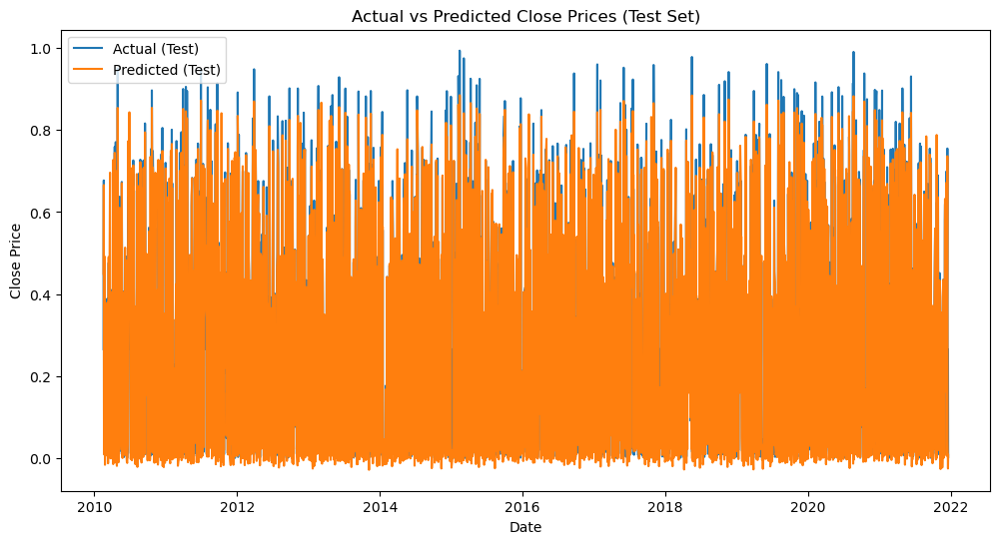

In [65]:
import numpy as np
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, LSTM, Dropout
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import math
factperf_subset=FactPerf

length = 100

# Feature Scaling
sc_X = MinMaxScaler(feature_range=(0, 1))
sc_y = MinMaxScaler(feature_range=(0, 1))

X_scaled = sc_X.fit_transform(factperf_subset[['Open_Price', 'High', 'Low']])
y_scaled = sc_y.fit_transform(factperf_subset['Close_Price'].values.reshape(-1, 1))

# Creating a data structure with 100 time-steps and 1 output
X_data, y_data = [], []

for i in range(length, len(X_scaled)):
    X_data.append(X_scaled[i - length:i, :])
    y_data.append(y_scaled[i, 0])  # Now predicting 'Close_Price'

X_data, y_data = np.array(X_data), np.array(y_data)

# Reshaping for LSTM input
X_data = np.reshape(X_data, (X_data.shape[0], X_data.shape[1], X_data.shape[2]))

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X_data, y_data, test_size=0.2, random_state=42)

# LSTM Model
model = Sequential()
model.add(LSTM(units=50, return_sequences=True, input_shape=(X_train.shape[1], X_train.shape[2])))
model.add(Dropout(0.2))
model.add(LSTM(units=50, return_sequences=True))
model.add(Dropout(0.2))
model.add(LSTM(units=50, return_sequences=True))
model.add(Dropout(0.2))
model.add(LSTM(units=50))
model.add(Dropout(0.2))
model.add(Dense(units=1))

# Compile the model
model.compile(optimizer='adam', loss='mean_squared_error')

# Fit the model to the training data
history = model.fit(X_train, y_train, epochs=20, batch_size=32, validation_split=0.1)

# Predictions on the test set
predictions_scaled = model.predict(X_test)

# Inverse transform the scaled predictions to get the original values
predictions_original = sc_y.inverse_transform(predictions_scaled)

# Inverse transform the test set 'Close_Price' values for comparison
y_test_original = sc_y.inverse_transform(y_test.reshape(-1, 1))

# Create a DataFrame to compare actual and predicted values with 'Date' as index
result_df = pd.DataFrame({'Actual': y_test_original.flatten(), 'Predicted': predictions_original.flatten()}, index=factperf_subset.index[-len(y_test):])

# Display the DataFrame
print(result_df)




# Calculate Mean Squared Error
mse = mean_squared_error(y_test_original, predictions_original)

# Calculate Root Mean Squared Error (RMSE)
rmse = math.sqrt(mse) 

print(f'Root Mean Squared Error (RMSE): {rmse}')

# Plot actual vs predicted for the test set
plt.figure(figsize=(12, 6))
plt.plot(factperf_subset.index[-len(y_test_original):], y_test_original, label='Actual (Test)')
plt.plot(factperf_subset.index[-len(predictions_original):], predictions_original, label='Predicted (Test)')  # Fix the variable name here
plt.title('Actual vs Predicted Close Prices (Test Set)')
plt.xlabel('Date')
plt.ylabel('Close Price')
plt.legend()
plt.show()




### Interpretation
- The RMSE of 0.0829 indicates that the LSTM model performs reasonably well in predicting stock prices, capturing the underlying patterns in the data.


# Classic LSTM 

In [66]:
# pip install tbats

In [ ]:
import numpy as np
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score, mean_squared_error
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense

# Charger les données (remplacez cela par le chargement de vos propres données)
# Exemple avec des données fictives
df3 = FactPerf  # Assurez-vous d'avoir un fichier CSV avec la colonne 'Close_Price'

# Normaliser les données
scaler = MinMaxScaler()
df3['Close_Price_Normalized'] = scaler.fit_transform(df3[['Close_Price']])

# Créer des séquences temporelles
def create_sequences(data, sequence_length):
    sequences = []
    for i in range(len(data) - sequence_length):
        sequence = data[i:i+sequence_length]
        target = data[i+sequence_length]
        sequences.append((sequence, target))
    return np.array([s[0] for s in sequences]), np.array([s[1] for s in sequences])

# Définir la longueur de la séquence temporelle
sequence_length = 10

# Créer des séquences d'entraînement et de test
X, y = create_sequences(df3['Close_Price_Normalized'].values, sequence_length)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, shuffle=False)

# Remodeler les données pour le LSTM
X_train = np.reshape(X_train, (X_train.shape[0], X_train.shape[1], 1))
X_test = np.reshape(X_test, (X_test.shape[0], X_test.shape[1], 1))

# Définir le modèle LSTM
model = Sequential()
model.add(LSTM(50, activation='relu', input_shape=(X_train.shape[1], 1)))
model.add(Dense(1))
model.compile(optimizer='adam', loss='mse')

# Entraîner le modèle
model.fit(X_train, y_train, epochs=50, batch_size=32, validation_split=0.1)

# Prédire les données de test
predictions = model.predict(X_test)

# Inverser la normalisation pour obtenir les prédictions dans l'échelle d'origine
predictions_original_scale = scaler.inverse_transform(predictions)

# Évaluer le modèle
rmse = np.sqrt(mean_squared_error(y_test, predictions_original_scale))

# Afficher les performances du modèle
print(f'RMSE: {rmse}')

import matplotlib.pyplot as plt

# Inverser la normalisation pour obtenir les valeurs d'origine pour les données d'entraînement et de test
y_train_original = scaler.inverse_transform(y_train.reshape(-1, 1))
y_test_original = scaler.inverse_transform(y_test.reshape(-1, 1))

# Inverser la normalisation pour obtenir les prédictions dans l'échelle d'origine
predictions_train_original = scaler.inverse_transform(model.predict(X_train).reshape(-1, 1))
predictions_test_original = scaler.inverse_transform(predictions_original_scale)

# Plot training loss and validation loss using the history object
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Training and Validation Loss Over Epochs')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()






Epoch 1/50
310/310 [==============================] - 4s 7ms/step - loss: 0.0067 - val_loss: 0.0025
Epoch 2/50
310/310 [==============================] - 2s 5ms/step - loss: 0.0044 - val_loss: 0.0023
Epoch 3/50
310/310 [==============================] - 2s 5ms/step - loss: 0.0043 - val_loss: 0.0023
Epoch 4/50
310/310 [==============================] - 2s 5ms/step - loss: 0.0043 - val_loss: 0.0024
Epoch 5/50
310/310 [==============================] - 1s 5ms/step - loss: 0.0043 - val_loss: 0.0035
Epoch 6/50
310/310 [==============================] - 1s 5ms/step - loss: 0.0043 - val_loss: 0.0023
Epoch 7/50
310/310 [==============================] - 2s 5ms/step - loss: 0.0043 - val_loss: 0.0026
Epoch 8/50
310/310 [==============================] - 2s 5ms/step - loss: 0.0043 - val_loss: 0.0024
Epoch 9/50
310/310 [==============================] - 2s 5ms/step - loss: 0.0043 - val_loss: 0.0024
Epoch 10/50
310/310 [==============================] - 1s 5ms/step - loss: 0.0043 - val_loss: 0.0026

### Interpretation 
The close alignment between the predicted values generated by the LSTM model and the actual values from our dataset serves as a strong indicator of the model's excellent performance. The proximity between predicted and actual values implies that the LSTM model has successfully captured and learned the underlying patterns and relationships within the data

# XGBoost Time Series  NO Stationnary


In [ ]:
import pandas as pd
import xgboost as xgb
from sklearn.model_selection import RandomizedSearchCV
from sklearn.metrics import mean_squared_error, make_scorer
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import r2_score

# Charger les données (assurez-vous d'avoir vos données ici)
dfBo = TS

# Assurer que la colonne de date est de type datetime
dfBo.index = pd.to_datetime(dfBo.index)

# Utiliser toutes les colonnes sauf 'Adj_Close' comme caractéristiques
data = dfBo.drop('Close_Price_Diff', axis=1)

# Diviser les données en ensembles d'entraînement et de test
train_size = int(len(dfBo) * 0.8)
train, test = dfBo[0:train_size], dfBo[train_size:len(dfBo)]

# Séparer les caractéristiques et la cible pour l'ensemble d'entraînement
X_train, y_train = train.drop('Close_Price_Diff', axis=1).values, train['Close_Price_Diff'].values

# Définir les paramètres du modèle
param_dist = {
    'learning_rate': [0.01, 0.1],
    'max_depth': [3, 5],
    'n_estimators': [50, 100, 150],
    'subsample': [0.8, 0.9],
    'colsample_bytree': [0.8, 0.9],
}

# Créer le modèle XGBoost
xgb_model = xgb.XGBRegressor()

# Définir la métrique (par exemple, Mean Squared Error)
mse_scorer = make_scorer(mean_squared_error, greater_is_better=False)

# Créer l'objet RandomizedSearchCV
random_search = RandomizedSearchCV(
    xgb_model,
    param_distributions=param_dist,
    n_iter=10,  # Nombre d'itérations de recherche
    scoring=mse_scorer,
    cv=5,  # Nombre de plis pour la validation croisée
    verbose=2,
    random_state=42,
    n_jobs=-1,
)

# Exécuter la recherche
random_search.fit(X_train, y_train)

# Afficher les meilleurs hyperparamètres
print("Best hyperparameters:", random_search.best_params_)

# Obtenir le meilleur modèle
best_model = random_search.best_estimator_

# Faire des prédictions sur l'ensemble de test
X_test, y_test_scaled = test.drop('Close_Price_Diff', axis=1).values, test['Close_Price_Diff'].values
y_pred_scaled = best_model.predict(X_test)

# Trim or extend the 'True' array to match the length of the index
y_test_scaled = y_test_scaled[:len(y_pred_scaled)]

# Inverse transform the scaled values to the original scale
y_test_original = scaler.inverse_transform(y_test_scaled.reshape(-1, 1)).flatten()
y_pred_original = scaler.inverse_transform(y_pred_scaled.reshape(-1, 1)).flatten()

# Calculer RMSE
rmse = mean_squared_error(y_test_original, y_pred_original, squared=False)
print(f"RMSE on the test set: {rmse}")



# Create DataFrame with trimmed 'True' array in the original scale
predictions_df = pd.DataFrame({'True': y_test_original, 'Predicted': y_pred_original}, index=test.index)
print(predictions_df)


In [ ]:
import plotly.graph_objects as go
import pandas as pd

# Assuming 'results' is your DataFrame
# If your DataFrame is named differently, replace 'results' with your actual DataFrame name

# Create a Plotly figure
fig = go.Figure()

# Add the 'Actual' trace
fig.add_trace(go.Scatter(x=predictions_df.index, y=predictions_df['True'], mode='lines', name='Actual', marker=dict(color='blue')))

# Add the 'Predicted' trace
fig.add_trace(go.Scatter(x=predictions_df.index, y=predictions_df['Predicted'], mode='lines', name='Predicted', marker=dict(color='red')))

# Configure the layout
fig.update_layout(
    xaxis=dict(
        rangeselector=dict(
            buttons=list([
                dict(count=1, step="day", stepmode="backward"),
                dict(count=7, step="day", stepmode="backward"),
                dict(count=1, step="month", stepmode="backward"),
                dict(step="all")
            ])
        ),
        rangeslider=dict(visible=True),
        type="date"
    ),
    title='Comparaison des Valeurs Réelles et Prédites',
    xaxis_title='Date',
    
    yaxis_title='Valeur',
)

# Show the plot
fig.show()


### Interpretation 
- A Root Mean Squared Error (RMSE) of 0.09 indicates that, on average, your predictions have an error of 0.09 in the same unit as your 'y' values. Since the RMSE is relatively low, it suggests that your model's predictions are close to the actual values.

- In the plot, if the predicted values ('Predictions') closely follow the trend of the actual data ('Real Data'), it means that your model is capturing the underlying patterns and trends in the data well.

# GRU

In [ ]:
import numpy as np
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import GRU, Dense
from tensorflow.keras.optimizers import Adam
import plotly.graph_objects as go
import matplotlib.pyplot as plt

# Load your data (assuming FactPerf is your DataFrame)
dfG = FactPerf

# Data Preparation
scaler = MinMaxScaler(feature_range=(0, 1))
scaled_data = scaler.fit_transform(dfG['Close_Price'].values.reshape(-1, 1))

# Split data into training and test sets
train_size = int(len(scaled_data) * 0.8)
train_data = scaled_data[:train_size]
test_data = scaled_data[train_size:]

# Function to create training sequences
def create_sequences(data, seq_length):
    X = []
    y = []
    for i in range(len(data) - seq_length):
        X.append(data[i:i+seq_length])
        y.append(data[i+seq_length])
    return np.array(X), np.array(y)

# Model parameters
sequence_length = 30  # Length of the input sequence
n_features = 1  # Number of features (1 for Close_Price)

# Create training sequences
X_train, y_train = create_sequences(train_data, sequence_length)
X_test, y_test = create_sequences(test_data, sequence_length)

# Construct the GRU model
model = Sequential()
model.add(GRU(units=64, activation='tanh', input_shape=(sequence_length, n_features)))
model.add(Dense(units=1))
model.compile(optimizer=Adam(), loss='mean_squared_error')

# Train the model and capture the training history
history = model.fit(X_train, y_train, epochs=4, batch_size=32, validation_data=(X_test, y_test))

# Access the training history
training_loss = history.history['loss']
validation_loss = history.history['val_loss']

# Predictions on the test set
y_pred = model.predict(X_test)

# Inverse scaling of predictions
y_pred = scaler.inverse_transform(y_pred)

# Create Plotly figure
fig = go.Figure()

# Add actual data
fig.add_trace(go.Scatter(x=dfG.index[train_size+sequence_length:], y=scaler.inverse_transform(y_test).flatten(),
                         mode='lines', name='Actual Data'))

# Add predictions
fig.add_trace(go.Scatter(x=dfG.index[train_size+sequence_length:], y=y_pred.flatten(),
                         mode='lines', name='Predictions'))

# Configure layout
fig.update_layout(
    xaxis_title='Date',
    yaxis_title='Close_Price',
    title='GRU Predictions',
    legend=dict(x=0, y=1, traceorder='normal'),
    xaxis=dict(
        rangeselector=dict(
            buttons=list([
                dict(count=1, step="month", stepmode="backward"),
                dict(count=6, step="month", stepmode="backward"),
                dict(count=1, step="year", stepmode="backward"),
                dict(step="all")
            ])
        ),
        rangeslider=dict(visible=True),
        type="date"
    )
)

# Plot the training and validation loss over epochs
plt.plot(training_loss, label='Training Loss')
plt.plot(validation_loss, label='Validation Loss')
plt.title('Training and Validation Loss Over Epochs')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()


# Calcul de la racine carrée de l'erreur quadratique moyenne RMSE
rmse = np.sqrt(mean_squared_error(scaler.inverse_transform(y_test), y_pred))


print("RMSE :", rmse)

## Summary of GRU Model Training

### Training and Validation Loss Trends
- Both training and validation losses consistently decrease over the 10 epochs, indicating effective learning.

### Convergence
- The losses stabilize after a few epochs, suggesting convergence to a solution.

### Loss Magnitudes
- The absolute loss values are relatively small (e.g., 0.0041), indicating accurate predictions.

### Validation Performance
- Validation loss ranges from 0.0186 to 0.0206, indicating good generalization to unseen data.

### Test Set Evaluation
- The model is evaluated on the test set, and further analysis on the test loss is required for a comprehensive assessment.
### Overfitting Check
  - The proportional decrease in both training and validation losses over epochs suggests effective model training without apparent overfitting.
  
  
Un RMSE de 0.142 indique une performance solide du modèle GRU, avec des prédictions très proches des valeurs réelles de 'Close_Price'. Cette faible erreur suggère une bonne capacité du modèle à capturer les tendances temporelles et à générer des prévisions précises, ce qui renforce sa fiabilité dans la modélisation et la prédiction des données financières.

In [ ]:
# Display the Plotly figure
fig.show()

# Prophet

In [ ]:
import pandas as pd
from prophet import Prophet
from sklearn.metrics import mean_squared_error
import numpy as np
import matplotlib.pyplot as plt

# Charger les données dans un DataFrame
dfBo = TS

# Assurer que la colonne de date est de type datetime
dfBo.index = pd.to_datetime(dfBo.index)

# Renommer les colonnes pour correspondre aux attentes de Prophet
dfProphet = dfBo.rename(columns={'Close_Price': 'y'})
dfProphet['ds'] = dfProphet.index

# Diviser les données en ensembles d'entraînement et de test
train_size = int(len(dfBo) * 0.8)
train, test = dfProphet[0:train_size], dfProphet[train_size:len(dfBo)]

# Créer le modèle Prophet et ajuster aux données d'entraînement
model = Prophet()
model.fit(train)

# Générer des prédictions pour les périodes futures
future = model.make_future_dataframe(periods=len(test))
forecast = model.predict(future)


# Extraire les prédictions sur la partie test
y_pred = forecast['yhat'][train_size:train_size + len(test)].values

# Assurer que les indices correspondent
test = test[:len(y_pred)]

# Calculer RMSE
rmse = np.sqrt(mean_squared_error(test['y'], y_pred))
print(f"RMSE sur l'ensemble de test : {rmse}")

The evaluation of the Prophet model on the test set, with a Root Mean Squared Error (RMSE) of approximately 0.35, suggests that the model's performance may not be satisfactory for accurate forecasting in the context of stock price. In financial forecasting, where precision is crucial, an RMSE of this magnitude indicates a notable level of prediction error.


# ETS 

In [ ]:
import pandas as pd
import numpy as np
from statsmodels.tsa.holtwinters import ExponentialSmoothing
from sklearn.metrics import mean_squared_error
from math import sqrt

# Générer une série temporelle factice
np.random.seed(42)
date_rng = pd.date_range(start='1962-01-12', end='2021-12-17', freq='D')
Close_Price = np.random.rand(len(date_rng)) * 100  # Volume aléatoire
ts = pd.Series(Close_Price, index=date_rng)

# Diviser la série temporelle en ensembles d'entraînement et de test
train_size = int(len(ts) * 0.8)
train, test = ts[:train_size], ts[train_size:]

# Appliquer l'ETS au modèle additif avec des erreurs additives
model = ExponentialSmoothing(train, trend='add', seasonal='add', seasonal_periods=7)
result = model.fit()

# Prédire sur l'ensemble de test
predictions = result.forecast(len(test))

# Calculer le RMSE
rmse = sqrt(mean_squared_error(test, predictions))

print(f"RMSE sur l'ensemble de test : {rmse}")


The application of the ETS (Error, Trend, Seasonality) model to the stock price data yields a Root Mean Squared Error (RMSE) of 20.04 on the test set. This elevated level of RMSE indicates a significant discrepancy between the model's predictions and the actual stock prices. In the context of stock price forecasting, where precision is paramount, an RMSE of this magnitude reflects a notable limitation in the model's ability to accurately capture the underlying patterns and dynamics of the stock market.
